# Generic Unet for Fiji 

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
from scipy.optimize import curve_fit
import skimage
from PIL import Image
import random
import utils
import shutil
import os

In [2]:
data='/home/ubuntu/Data/'

In [3]:
base_scaler=32

In [5]:
x_dim=128
y_dim=128
channels=1

mean=147.0
std=134.0

# Get data

Load data from file

In [27]:
both=skimage.external.tifffile.imread(data+'TrainingWindowed_RotShift.tif')
both=np.swapaxes(np.swapaxes(both,2,3), 3,4)

x_dim=both.shape[1]
y_dim=both.shape[2]
channels=both.shape[3]-3

In [28]:
train_data=both[:,:,:,:,[0]]
train_truth=both[:,:,:,:,[3]]

both=0

#non_zeros=np.where(train_data!=0)
#mean=np.mean(train_data)
#std=np.std(train_data)


train_data=(train_data-mean)/(std*1)+0.5
train_truth[np.where(train_truth>0.1)]=1
train_truth[np.where(train_truth<0)]=0



In [29]:
validation=skimage.external.tifffile.imread(data+'Validation.tif')
validation=np.swapaxes(np.swapaxes(validation,2,3), 3,4)

validation_data=validation[:,:,:,:,[0]]
validation_data=(validation_data-mean)/(std*1)+0.5

validation_truth=validation[:,:,:,:,[3]]
validation_truth[np.where(validation_truth>0.1)]=1
validation_truth[np.where(validation_truth<0)]=0

In [30]:
print([mean, std])

[147.0, 134.0]


# Design network

Define a function to create a convolutional layer, including conv, relu, maxpool, that can be called multiple times

In [3]:
tf.reset_default_graph()
#Input and output
x=tf.placeholder(dtype=tf.float32, shape=[None, 8, 128,128,1])
y=tf.placeholder(dtype=tf.float32, shape=[None, 8, 128,128,1])

lr=tf.placeholder(dtype=tf.float32, shape=[], name='learning_rate')
dr=tf.placeholder(dtype=tf.float32, shape=[], name='dropout_rate')

regularizer = tf.contrib.layers.l2_regularizer(scale=0.1)

xr=x
yr=y

base_scaler=32

#Going down
A1=utils.leaky_relu(tf.layers.conv3d(xr, base_scaler, [3,5,5], padding='SAME', kernel_regularizer=regularizer))
A2=utils.leaky_relu(tf.layers.conv3d(A1, base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

B0=tf.nn.max_pool3d(A2, ksize=[1,1,2,2,1], strides=[1,1,2,2,1], padding='SAME')
B1=utils.leaky_relu(tf.layers.conv3d(B0, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
B2=utils.leaky_relu(tf.layers.conv3d(B1, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

C0=tf.nn.max_pool3d(B2, ksize=[1,2,2,2,1], strides=[1,2,2,2,1], padding='SAME')
C1=utils.leaky_relu(tf.layers.conv3d(C0, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
C2=utils.leaky_relu(tf.layers.conv3d(C1, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

D0=tf.nn.max_pool3d(C2, ksize=[1,1,2,2,1], strides=[1,1,2,2,1], padding='SAME')
D1=utils.leaky_relu(tf.layers.conv3d(D0, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
D2=utils.leaky_relu(tf.layers.conv3d(D1, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

E0=tf.nn.max_pool3d(D2, ksize=[1,2,2,2,1], strides=[1,2,2,2,1], padding='SAME')
E1=utils.leaky_relu(tf.layers.conv3d(E0, 16*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
E2=utils.leaky_relu(tf.layers.conv3d(E1, 16*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

#Coming up
DD0=tf.layers.conv3d_transpose(E2, 8*base_scaler, kernel_size=[3,3,3], strides=[2,2, 2], padding='SAME')
DD1=tf.concat(axis=4, values=[DD0,D2])
DD2=utils.leaky_relu(tf.layers.conv3d(DD1, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
DD3=utils.leaky_relu(tf.layers.conv3d(DD2, 8*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

CC0=tf.layers.conv3d_transpose(DD3, 4*base_scaler, kernel_size=[3,3,3], strides=[1,2, 2], padding='SAME')
CC1=tf.concat(axis=4, values=[CC0,C2])
CC2=utils.leaky_relu(tf.layers.conv3d(CC1, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
CC3=utils.leaky_relu(tf.layers.conv3d(CC2, 4*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

BB0=tf.layers.conv3d_transpose(CC3, 2*base_scaler, kernel_size=[3,3,3], strides=[2,2, 2], padding='SAME')
#BB0=tf.contrib.layers.conv2d_transpose(C2, 2*base_scaler, kernel_size=[3,3], stride=[2, 2], padding='SAME')
BB1=tf.concat(axis=4, values=[BB0,B2])
BB2=utils.leaky_relu(tf.layers.conv3d(BB1, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
BB3=utils.leaky_relu(tf.layers.conv3d(BB2, 2*base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

AA0=tf.layers.conv3d_transpose(BB3, base_scaler, kernel_size=[3,3,3], strides=[1,2, 2], padding='SAME')
AA1=tf.concat(axis=4, values=[AA0,A2])
AA2=utils.leaky_relu(tf.layers.conv3d(AA1, base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))
AA3=utils.leaky_relu(tf.layers.conv3d(AA2, base_scaler, [3,3,3], padding='SAME', kernel_regularizer=regularizer))

logits=utils.leaky_relu(tf.layers.conv3d(AA3, 1, [1,1,1], padding='SAME', kernel_regularizer=regularizer))
probs=tf.tanh(logits, name='probabilities')

diff=tf.subtract(probs, yr)
LSQ=tf.multiply(diff,diff)
loss=1*tf.reduce_mean(LSQ[:,:,:,:,0])#+0.1*tf.reduce_mean(LSQ[:,:,:,:,1])+5*tf.reduce_mean(LSQ[:,:,:,:,2])
#Added this to make the outlines more potent in error function
#OutError, MaskError=tf.split(LSQ, [1,1], 3)
#loss=1*tf.reduce_mean(OutError)+0.1*tf.reduce_mean(MaskError)
l2_loss = tf.losses.get_regularization_loss()
#loss=loss+l2_loss/1000

train_op=tf.train.AdamOptimizer(learning_rate=lr, name='trainer').minimize(loss)

tf.summary.scalar('loss', loss)
#tf.summary.image('input', x, 10)
#tf.summary.image('standard', y, 10)
#tf.summary.image('processed', probs, 10)


merge = tf.summary.merge_all()

AttributeError: module 'tensorflow' has no attribute 'reset_default_graph'

# Training

0
Training loss:  0.09355412
(3, 8, 128, 128, 1)
Validation loss:  0.042328212


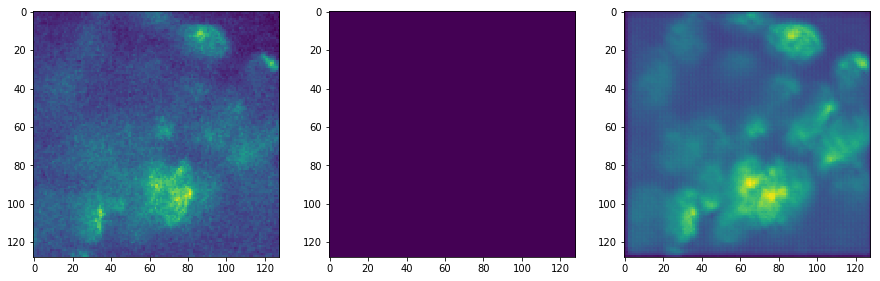

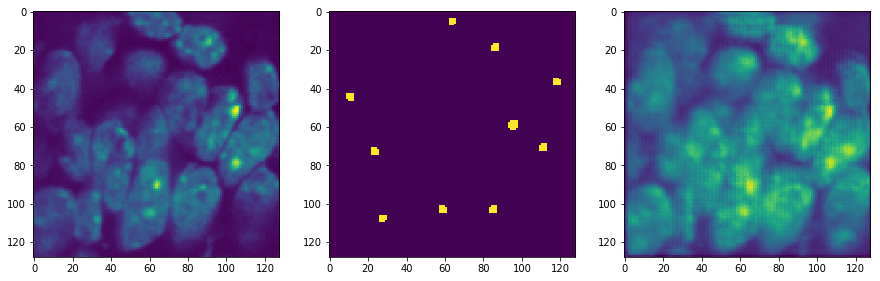

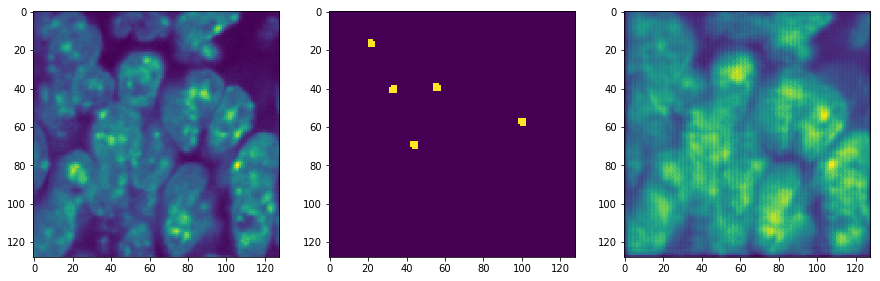

100
Training loss:  0.0058479877
(3, 8, 128, 128, 1)
Validation loss:  0.005906986


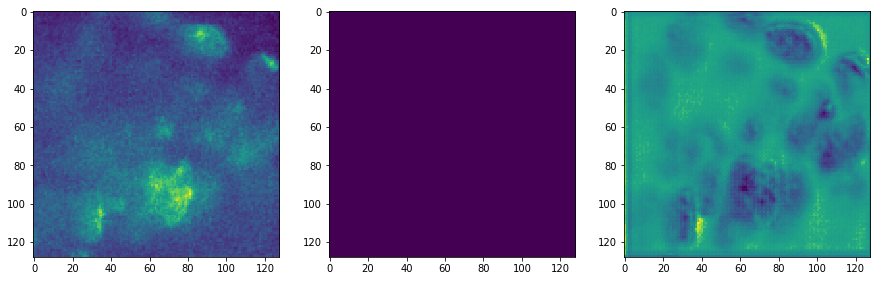

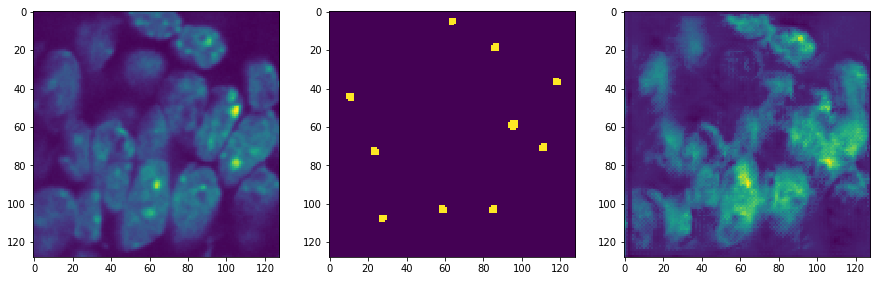

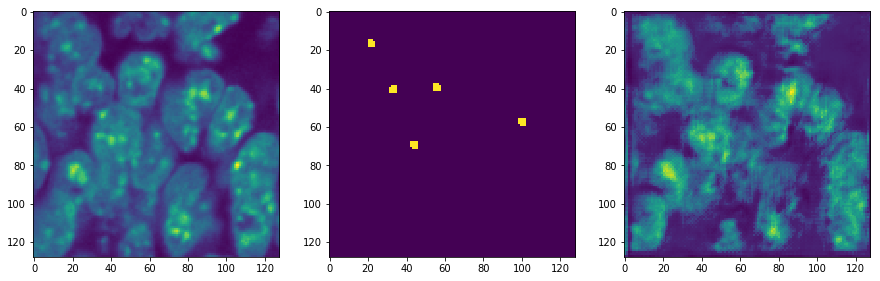

200
Training loss:  0.007915898
(3, 8, 128, 128, 1)
Validation loss:  0.0059057525


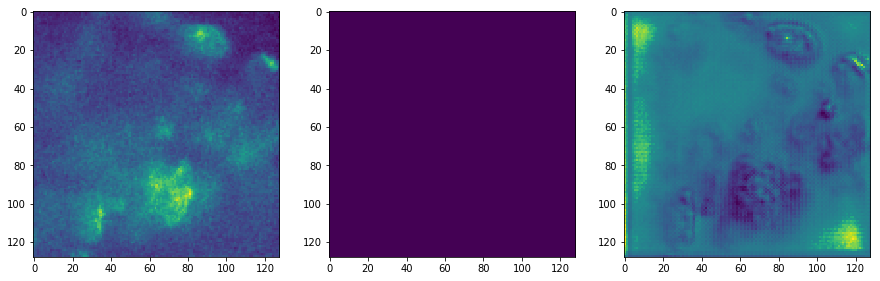

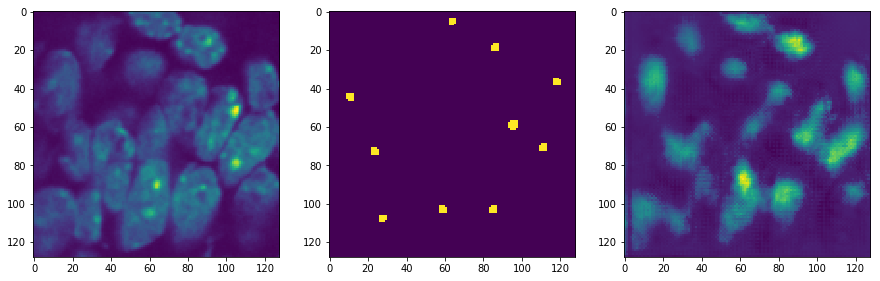

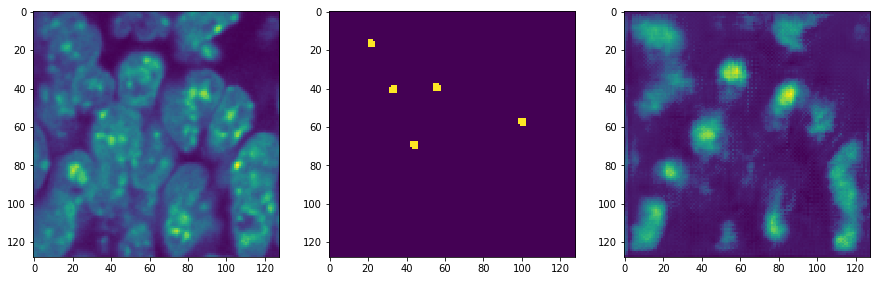

300
Training loss:  0.004289742
(3, 8, 128, 128, 1)
Validation loss:  0.005961901


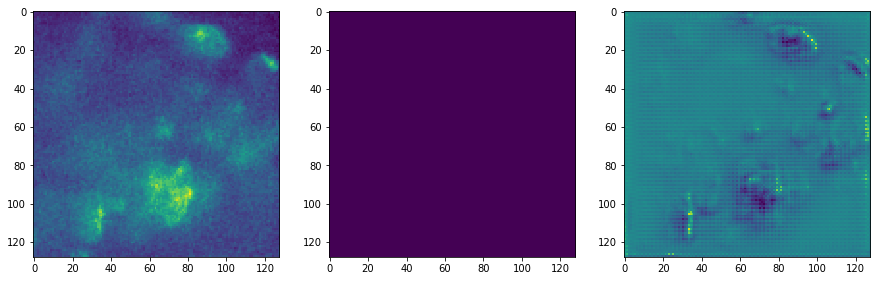

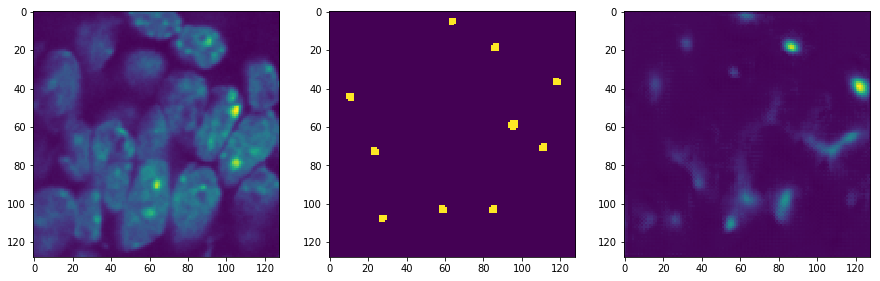

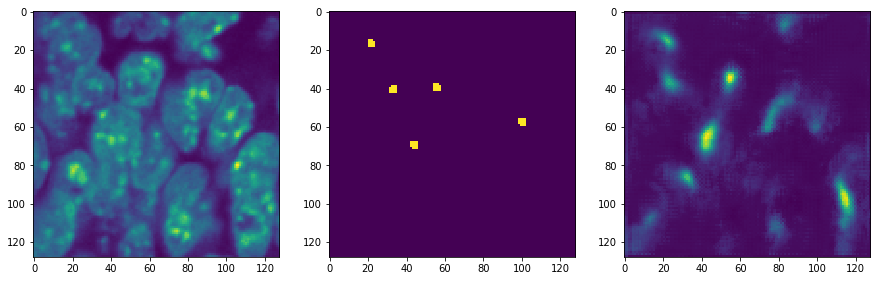

400
Training loss:  0.006796441
(3, 8, 128, 128, 1)
Validation loss:  0.0059330277


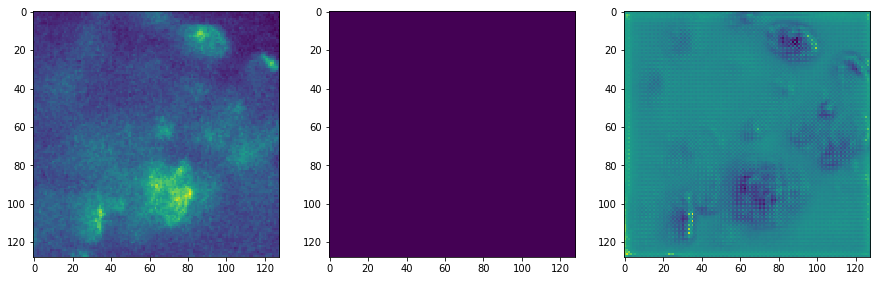

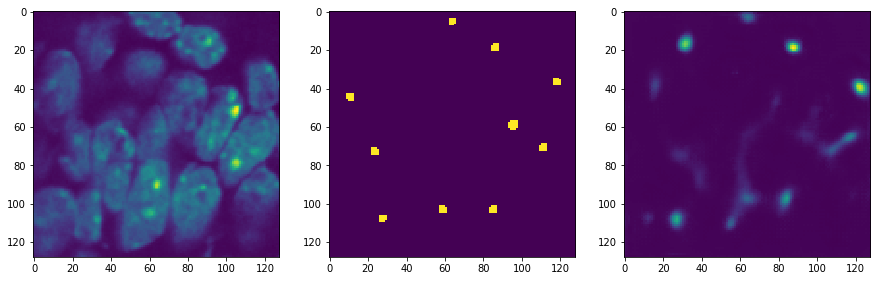

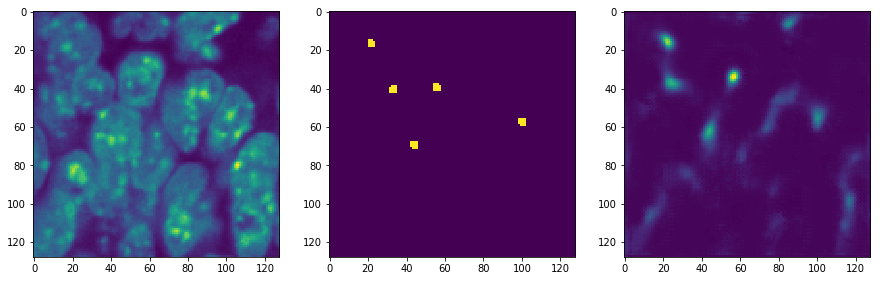

500
Training loss:  0.00356954
(3, 8, 128, 128, 1)
Validation loss:  0.0064390153


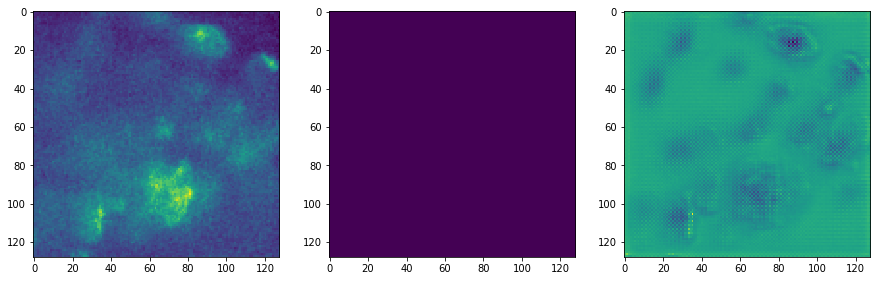

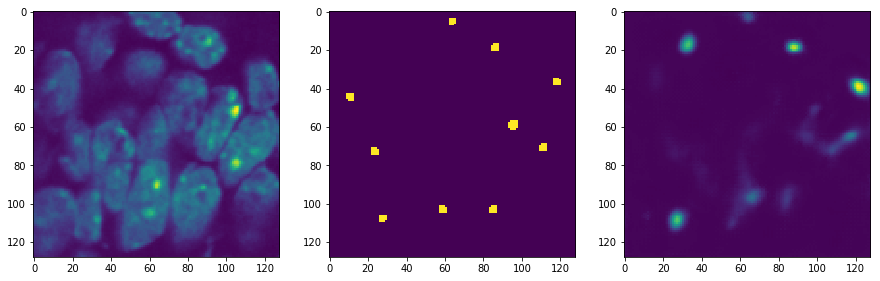

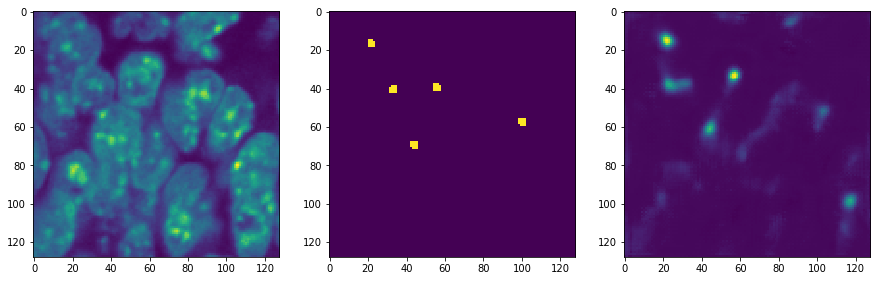

600
Training loss:  0.0050733555
(3, 8, 128, 128, 1)
Validation loss:  0.006626046


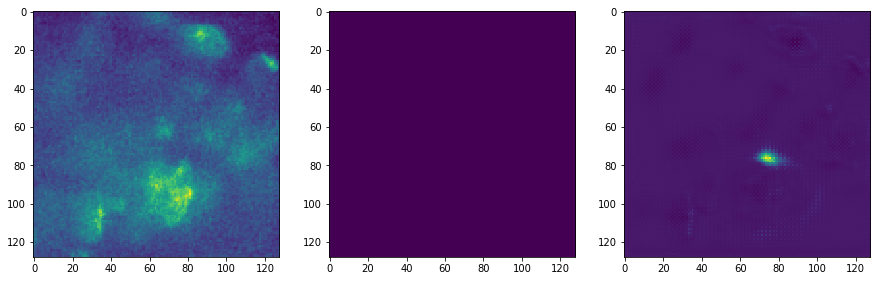

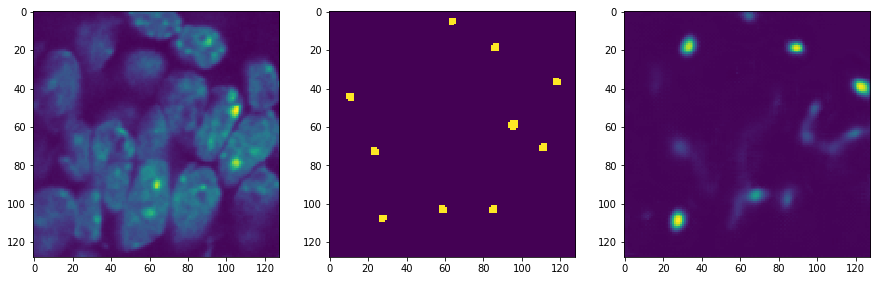

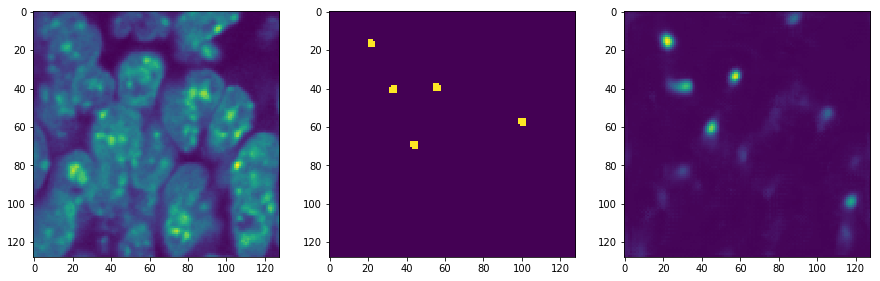

700
Training loss:  0.004573604
(3, 8, 128, 128, 1)
Validation loss:  0.0066053816


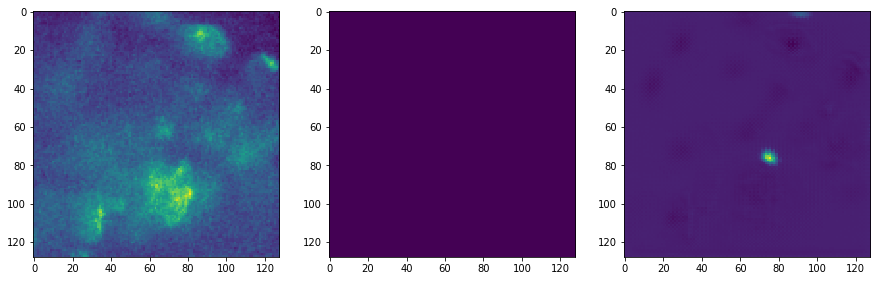

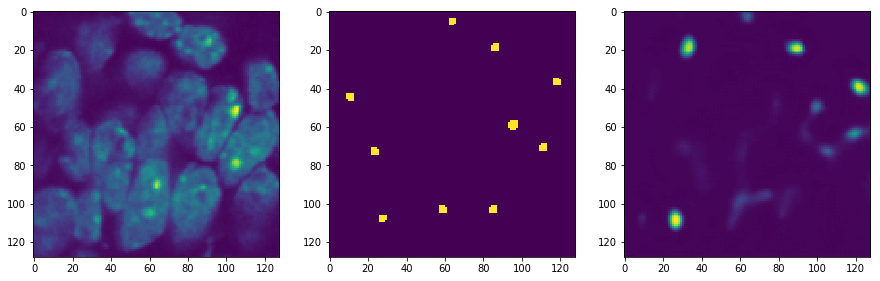

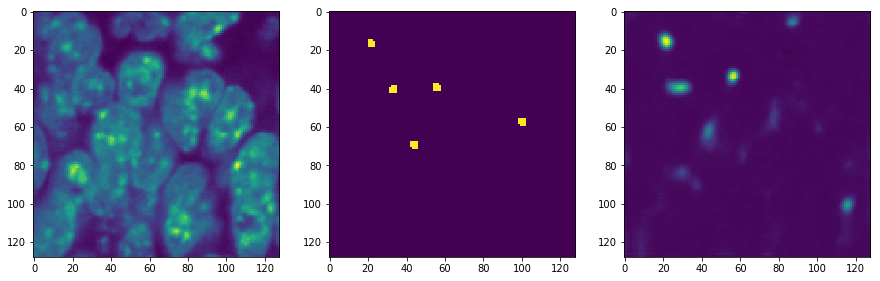

800
Training loss:  0.004129299
(3, 8, 128, 128, 1)
Validation loss:  0.0068387077


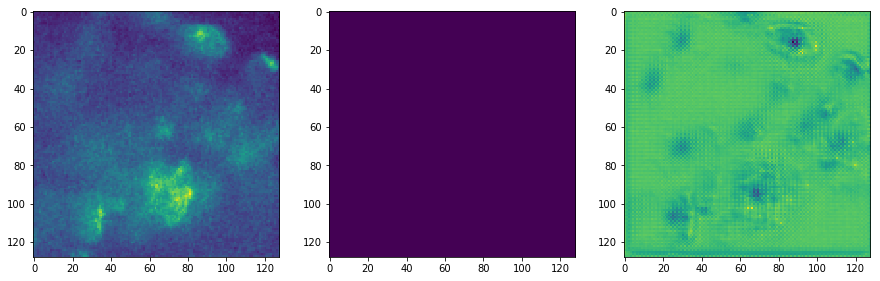

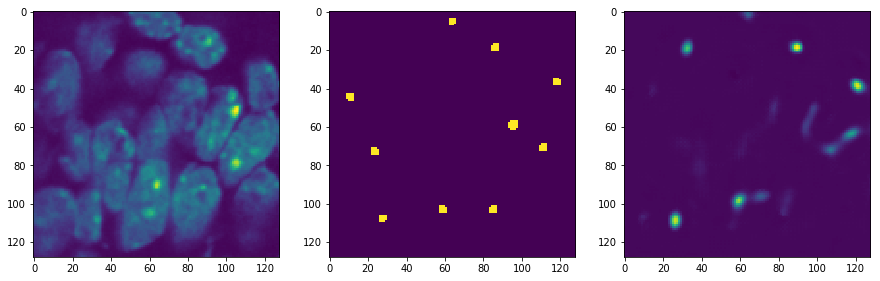

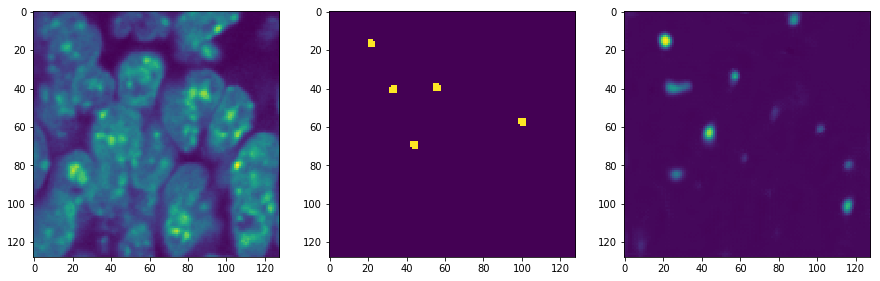

900
Training loss:  0.0053219358
(3, 8, 128, 128, 1)
Validation loss:  0.0073640137


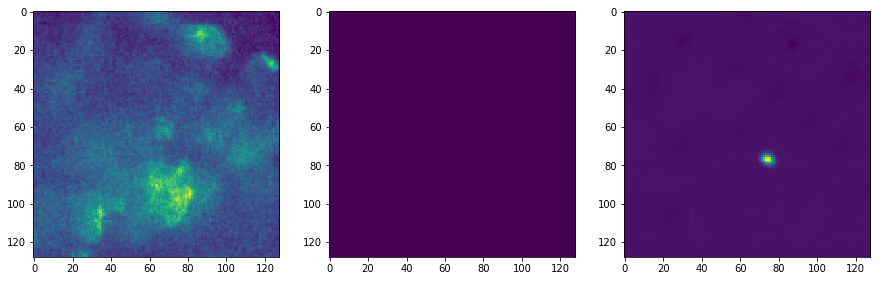

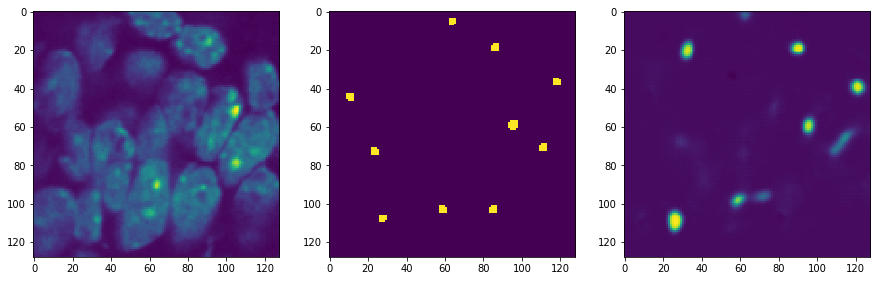

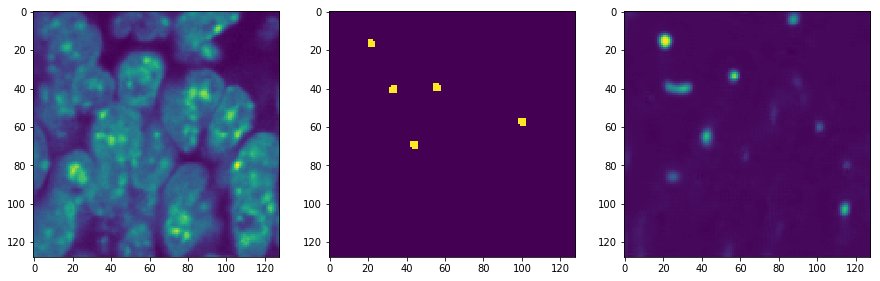

1000
Training loss:  0.0057039154
(3, 8, 128, 128, 1)
Validation loss:  0.0073405392


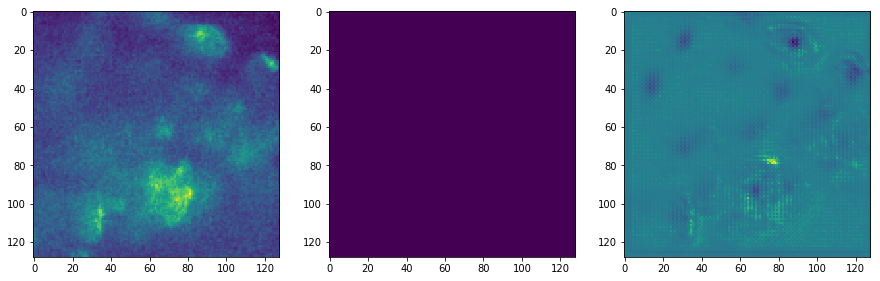

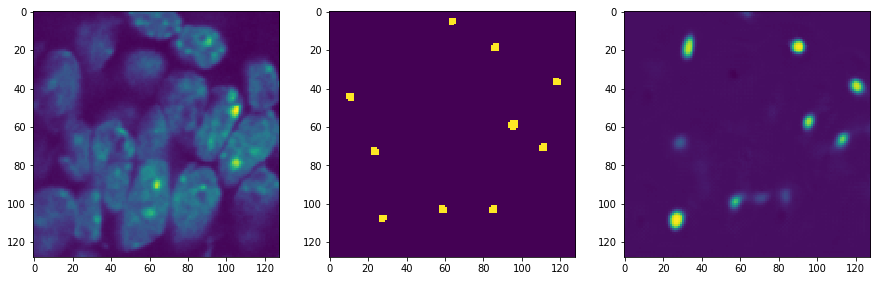

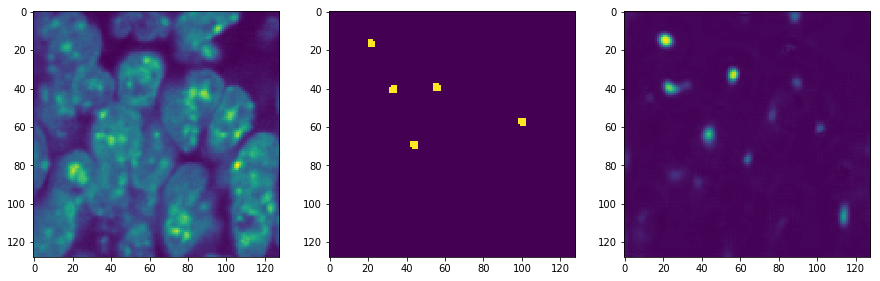

1100
Training loss:  0.004504044
(3, 8, 128, 128, 1)
Validation loss:  0.007408381


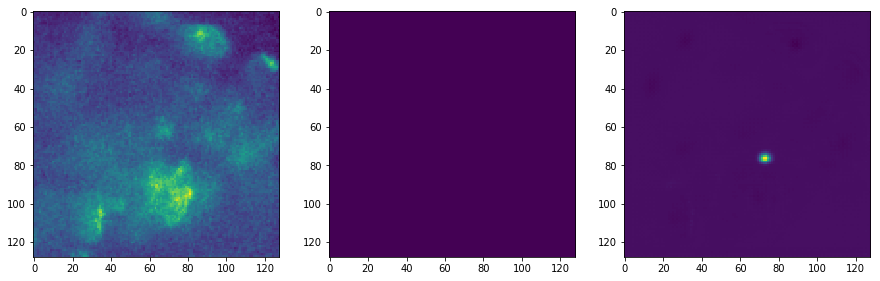

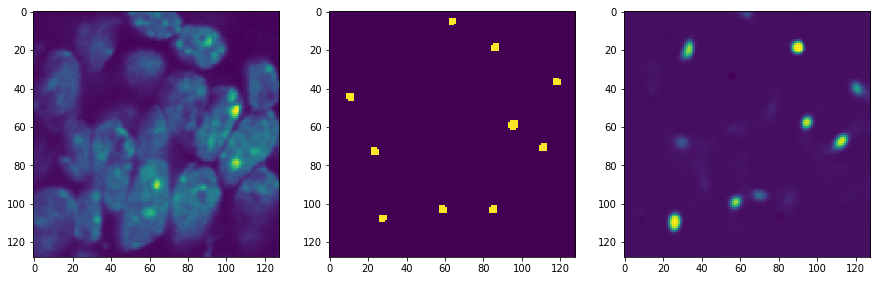

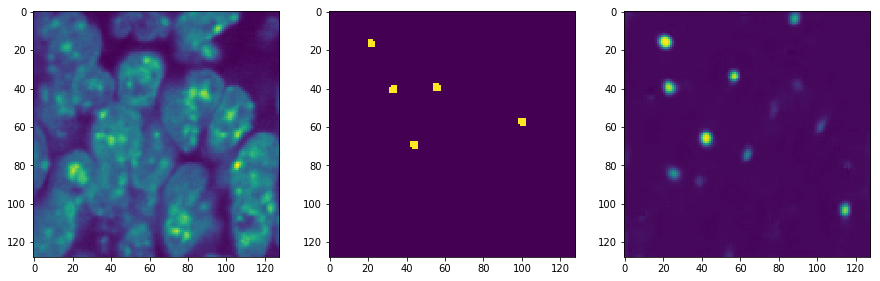

1200
Training loss:  0.0038726614
(3, 8, 128, 128, 1)
Validation loss:  0.007133922


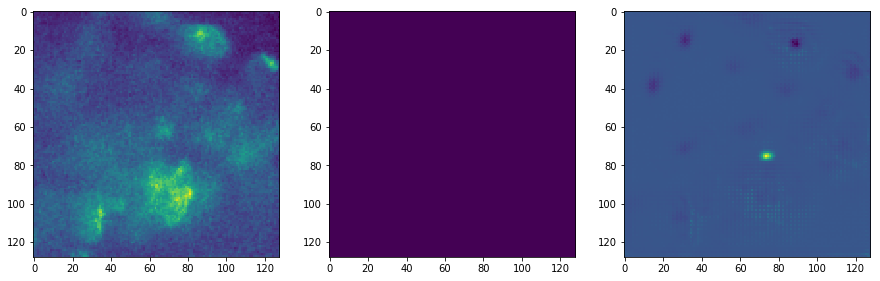

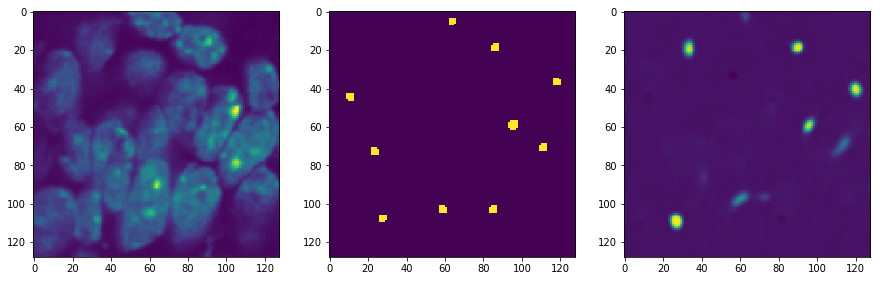

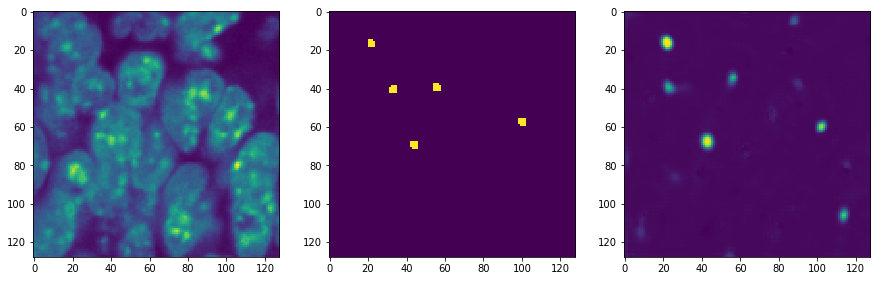

1300
Training loss:  0.0029732874
(3, 8, 128, 128, 1)
Validation loss:  0.008576824


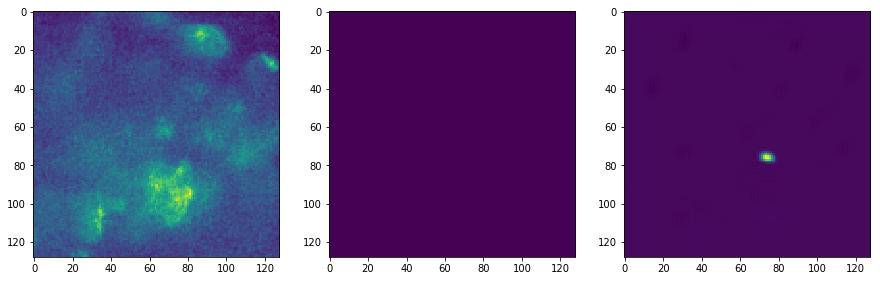

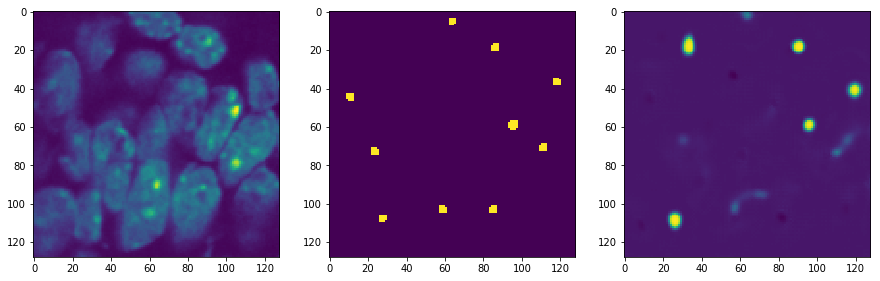

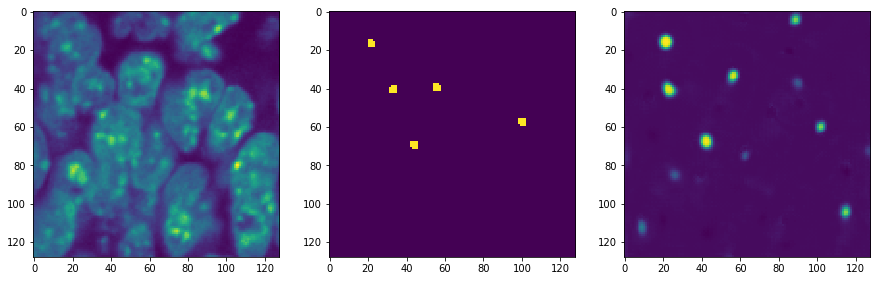

1400
Training loss:  0.0027459008
(3, 8, 128, 128, 1)
Validation loss:  0.0086199865


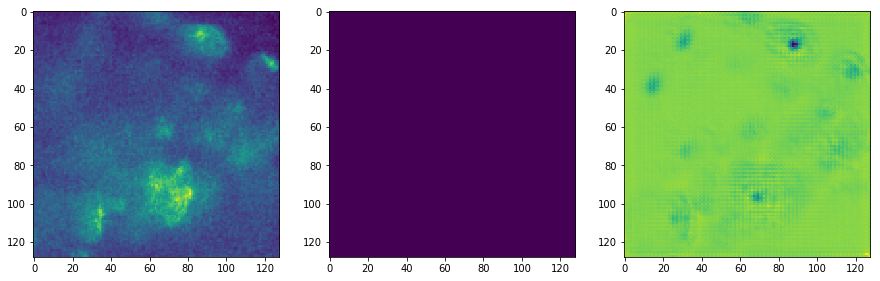

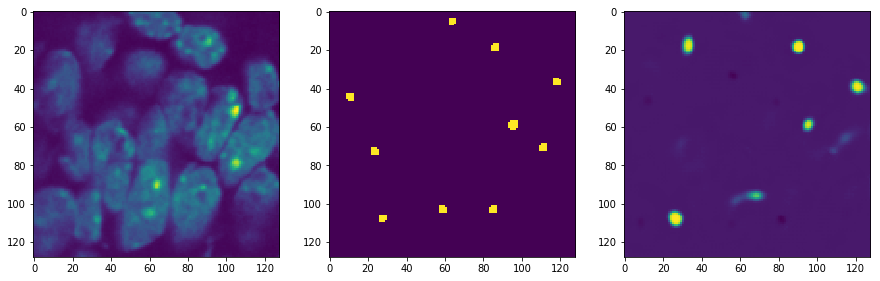

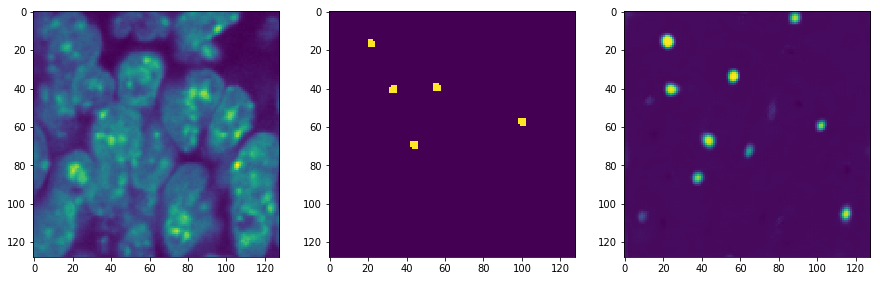

1500
Training loss:  0.0018726871
(3, 8, 128, 128, 1)
Validation loss:  0.007728195


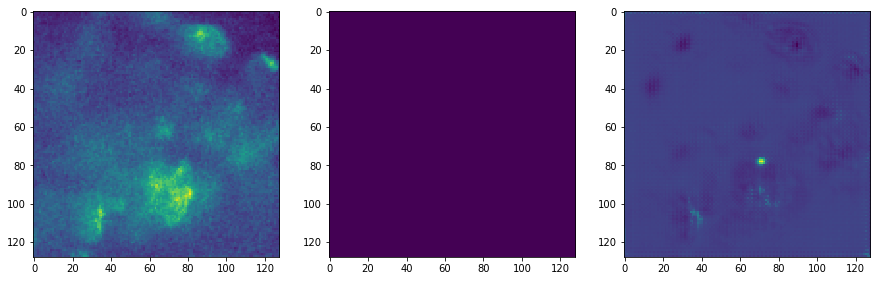

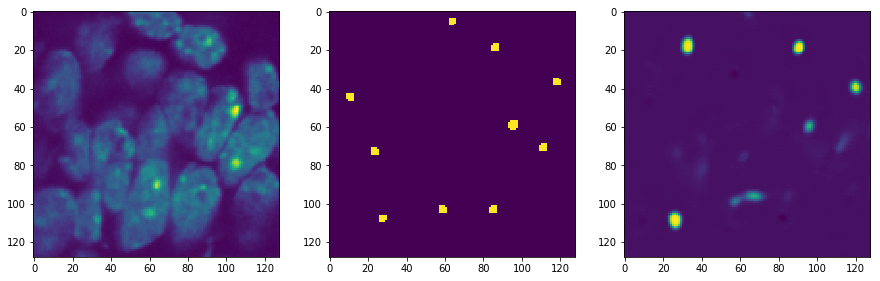

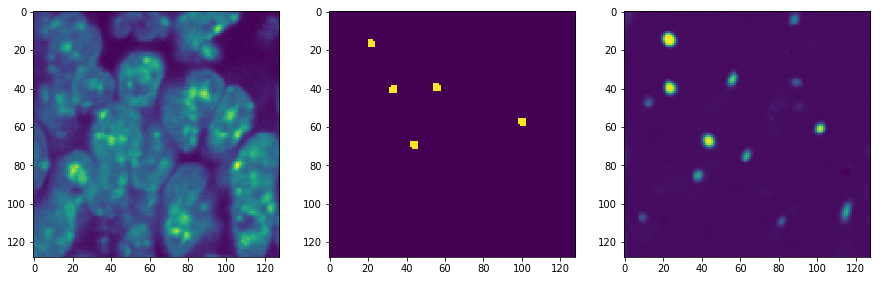

1600
Training loss:  0.00272616
(3, 8, 128, 128, 1)
Validation loss:  0.0074149384


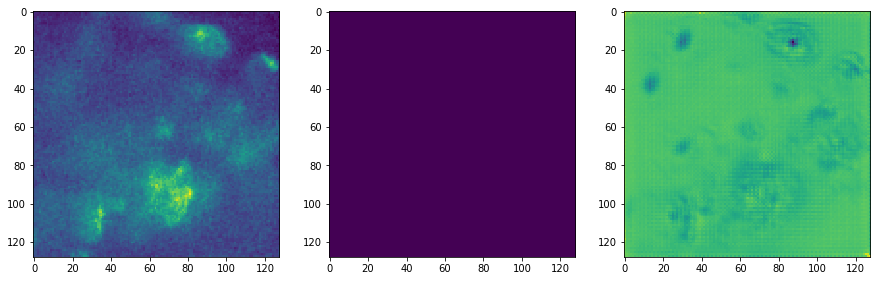

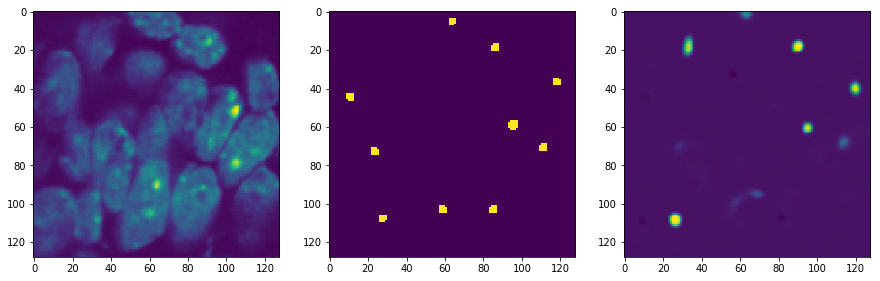

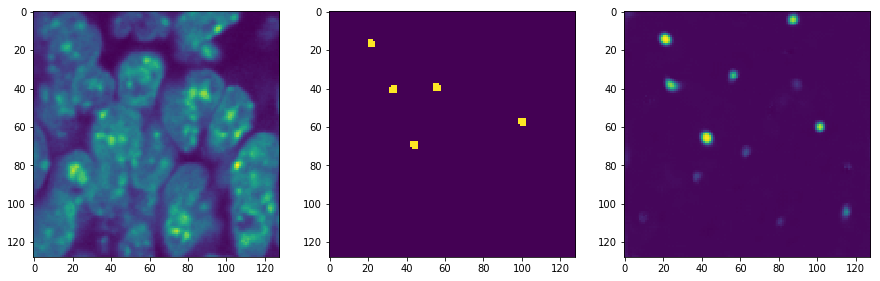

1700
Training loss:  0.0017837684
(3, 8, 128, 128, 1)
Validation loss:  0.008239033


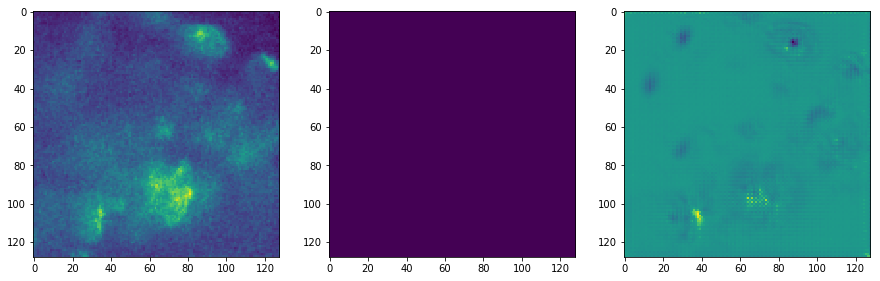

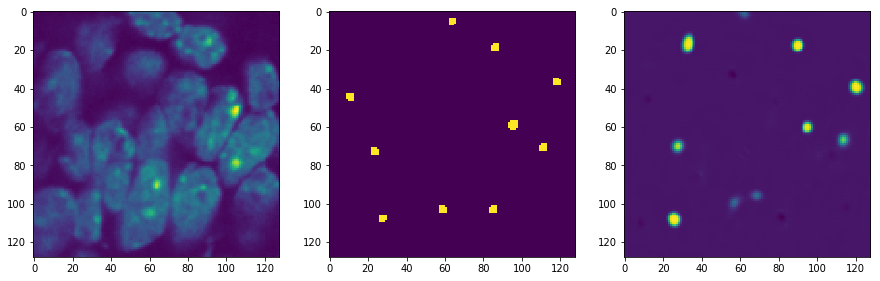

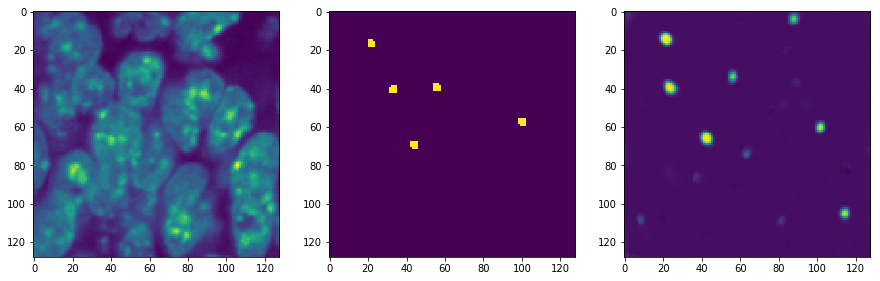

1800
Training loss:  0.0019977256
(3, 8, 128, 128, 1)
Validation loss:  0.009572375


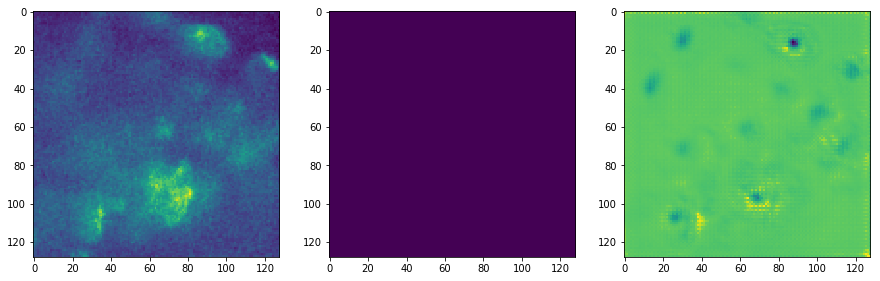

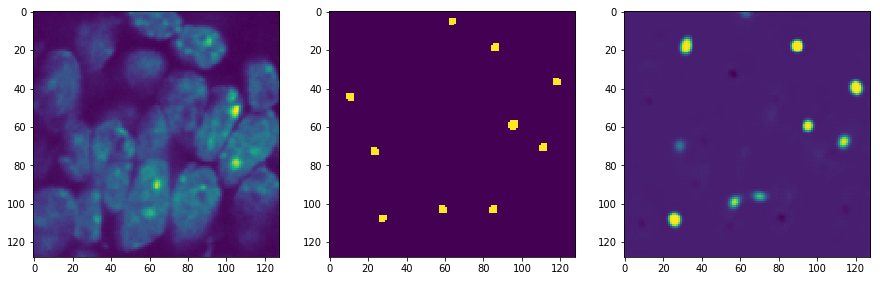

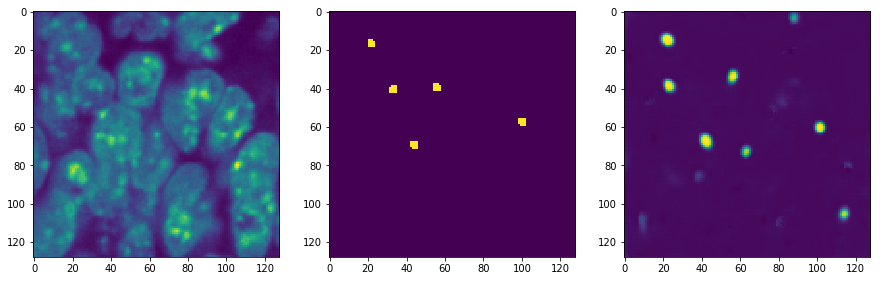

1900
Training loss:  0.0028187365
(3, 8, 128, 128, 1)
Validation loss:  0.008486689


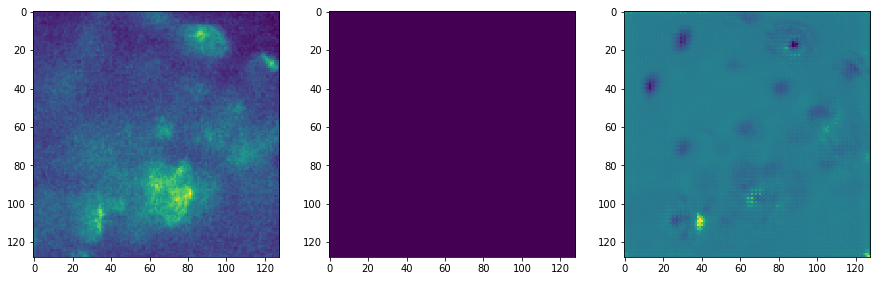

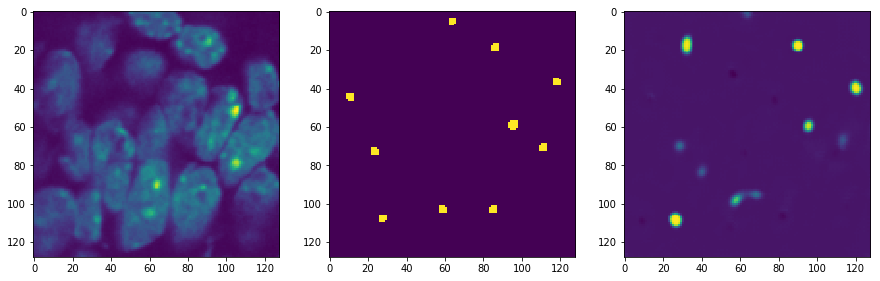

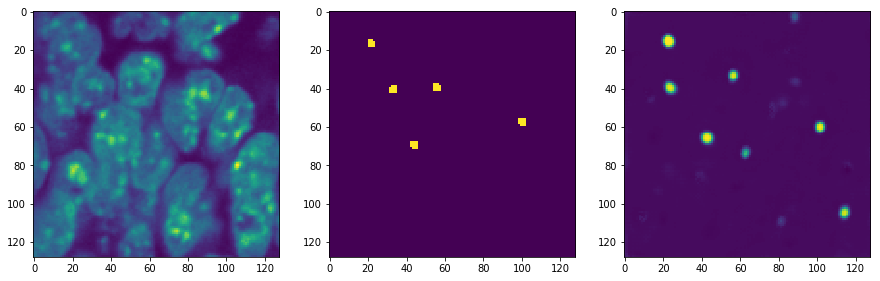

2000
Training loss:  0.002229904
(3, 8, 128, 128, 1)
Validation loss:  0.00900609


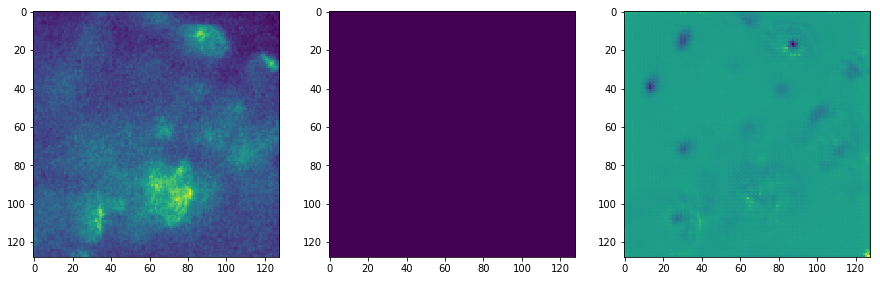

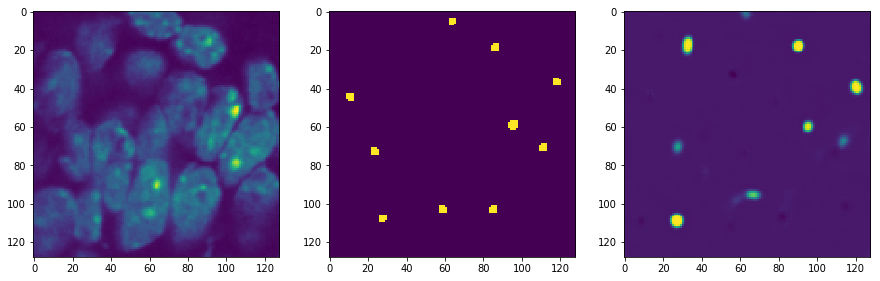

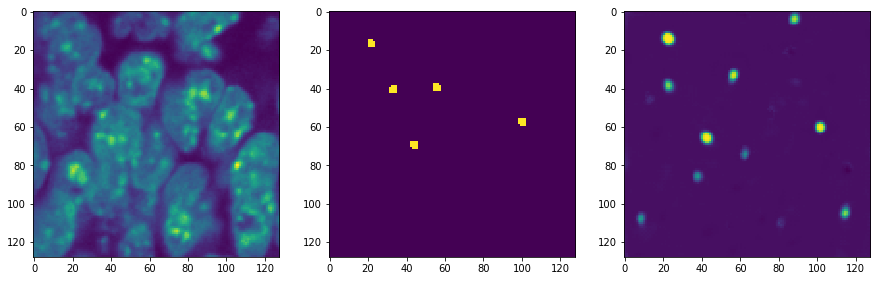

2100
Training loss:  0.002351952
(3, 8, 128, 128, 1)
Validation loss:  0.007809156


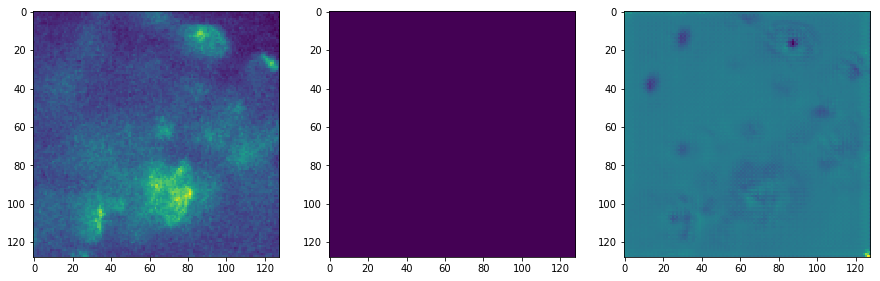

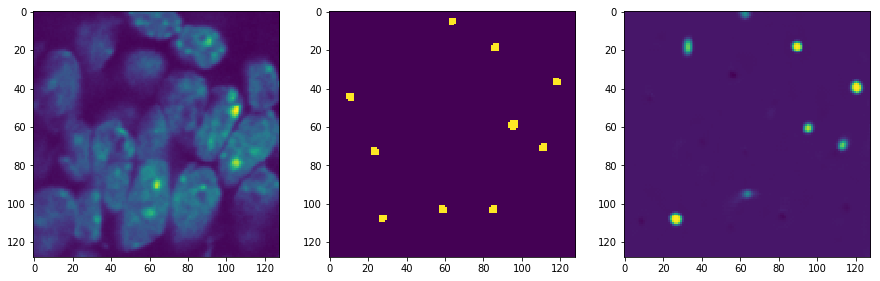

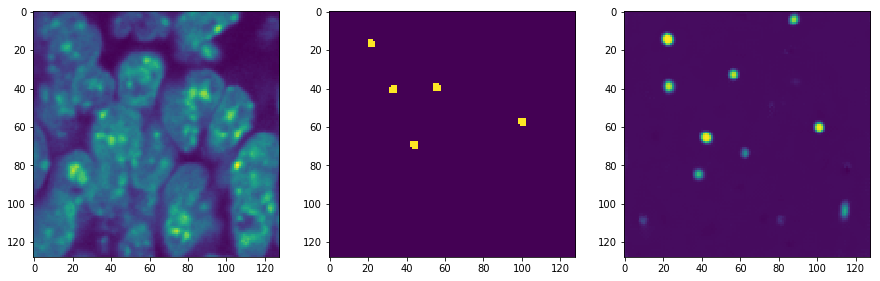

2200
Training loss:  0.0030131184
(3, 8, 128, 128, 1)
Validation loss:  0.009185519


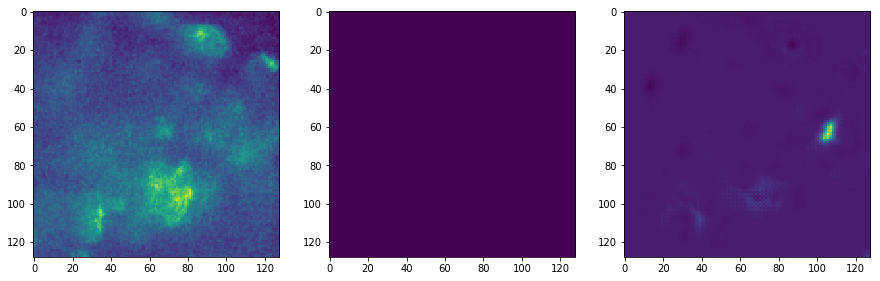

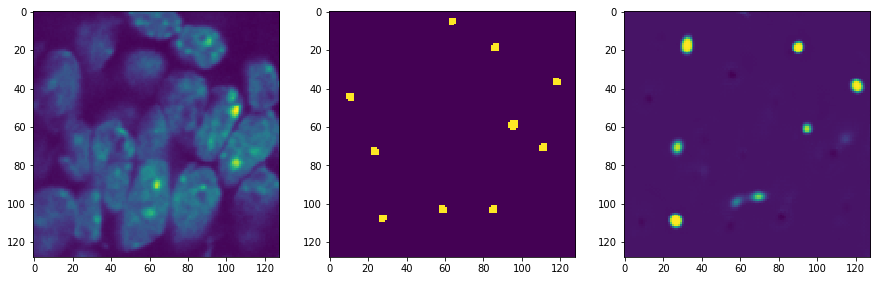

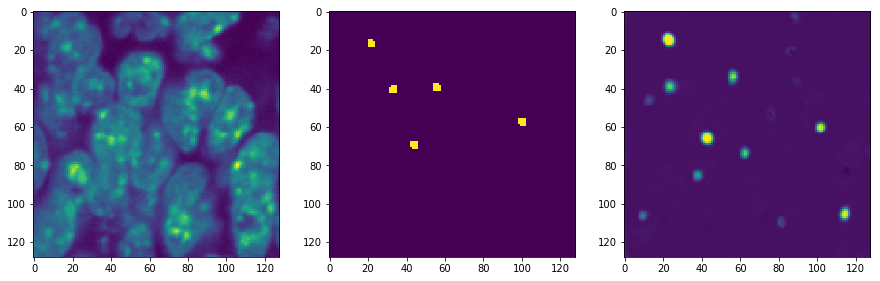

2300
Training loss:  0.0018744343
(3, 8, 128, 128, 1)
Validation loss:  0.009024394


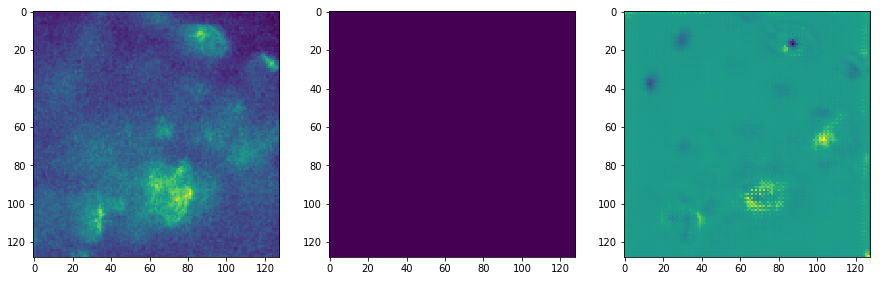

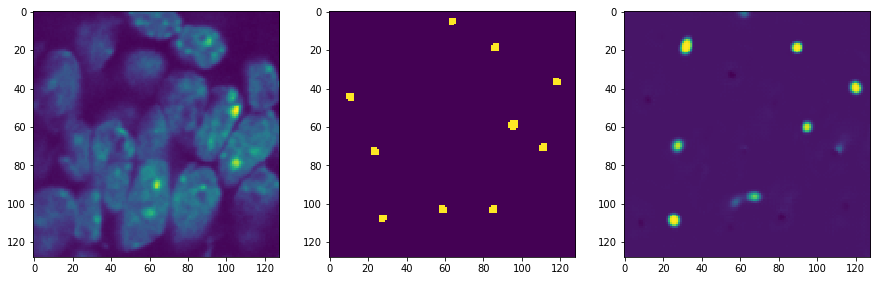

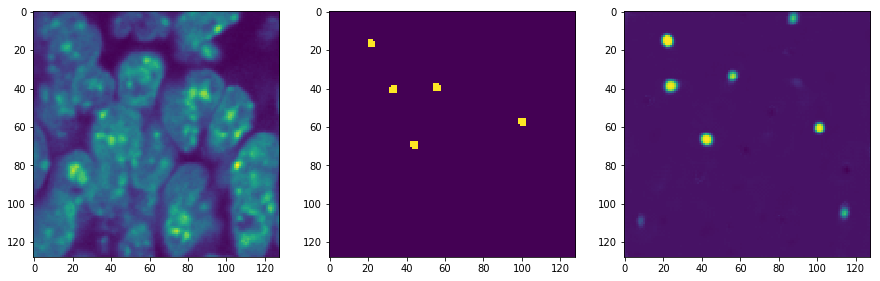

2400
Training loss:  0.0019313403
(3, 8, 128, 128, 1)
Validation loss:  0.008890905


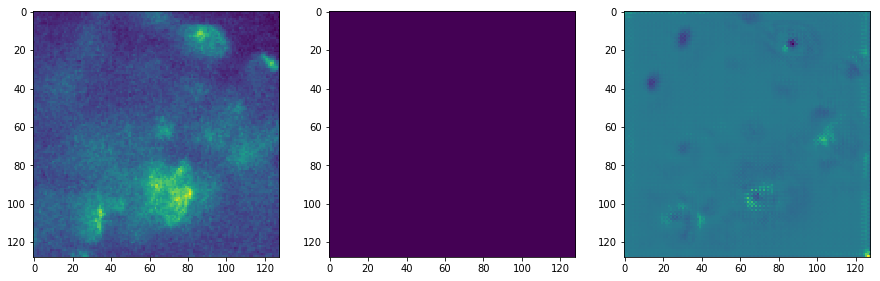

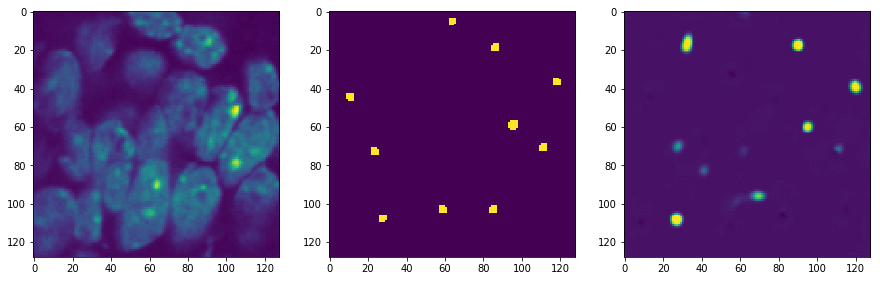

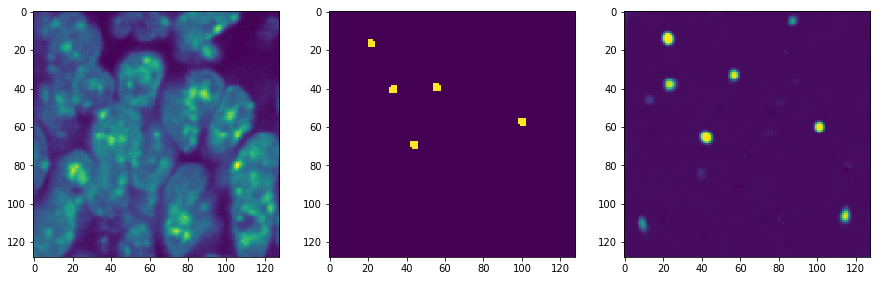

2500
Training loss:  0.0022382434
(3, 8, 128, 128, 1)
Validation loss:  0.008090501


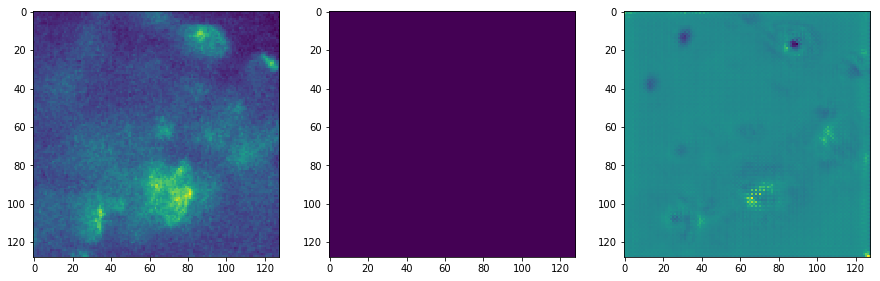

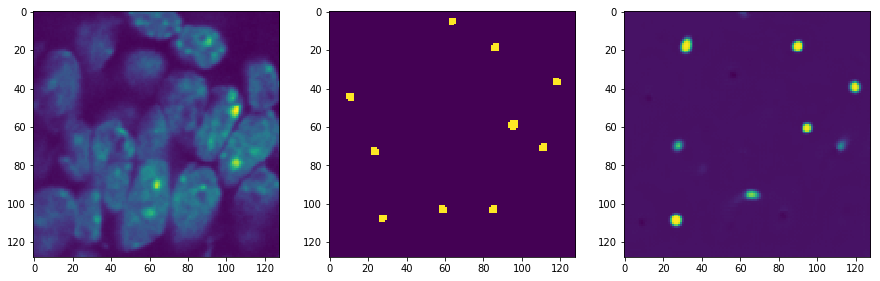

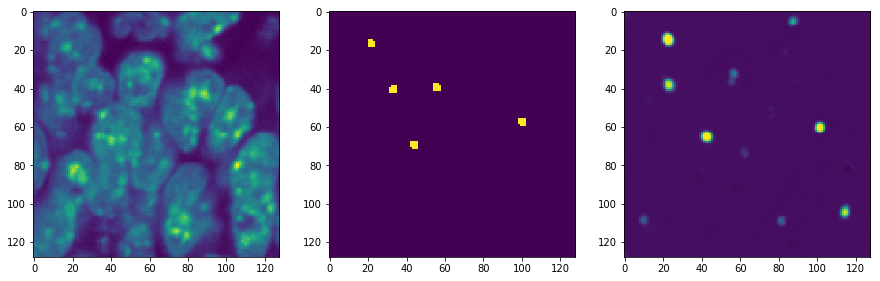

2600
Training loss:  0.0011940468
(3, 8, 128, 128, 1)
Validation loss:  0.008308443


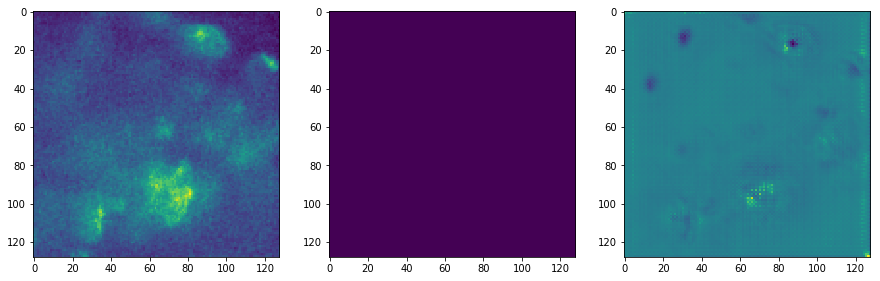

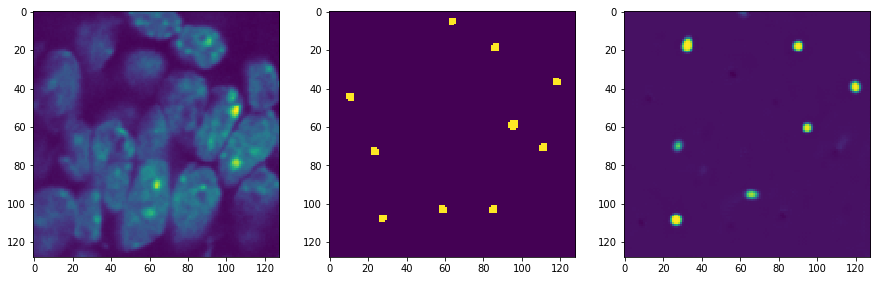

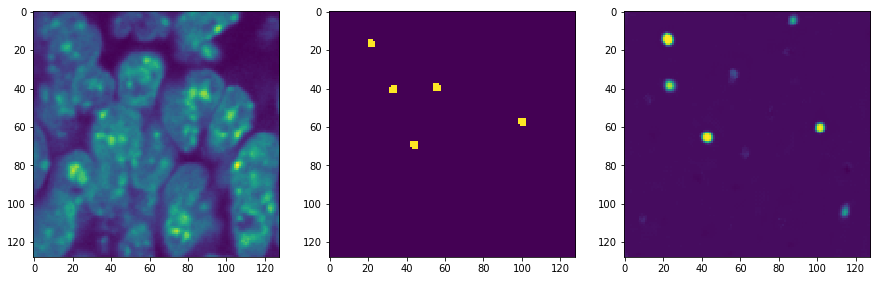

2700
Training loss:  0.0016883557
(3, 8, 128, 128, 1)
Validation loss:  0.00890915


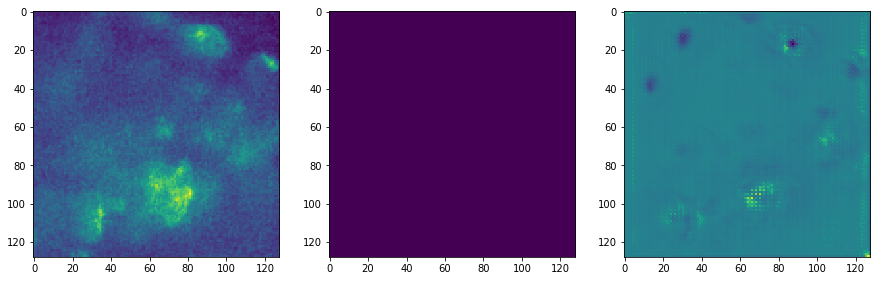

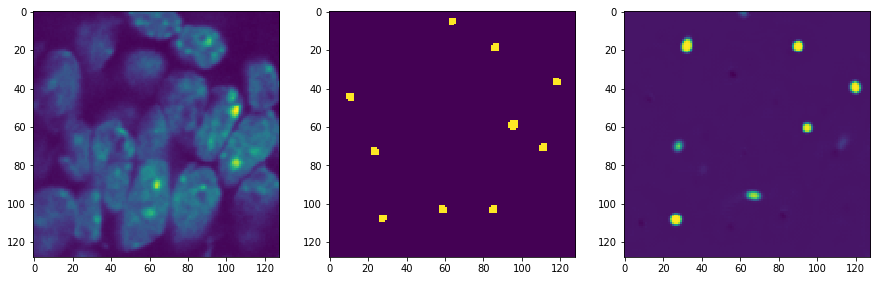

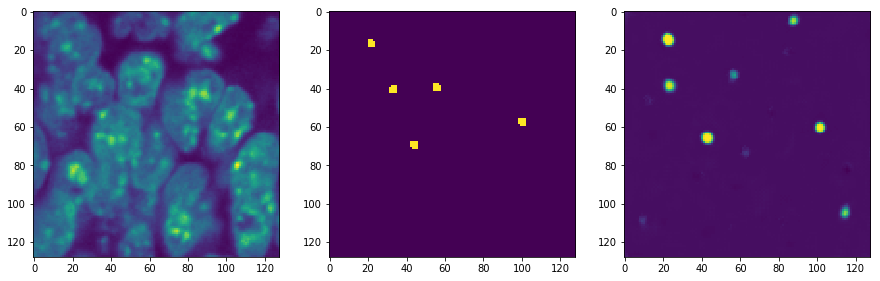

2800
Training loss:  0.0019633484
(3, 8, 128, 128, 1)
Validation loss:  0.009206886


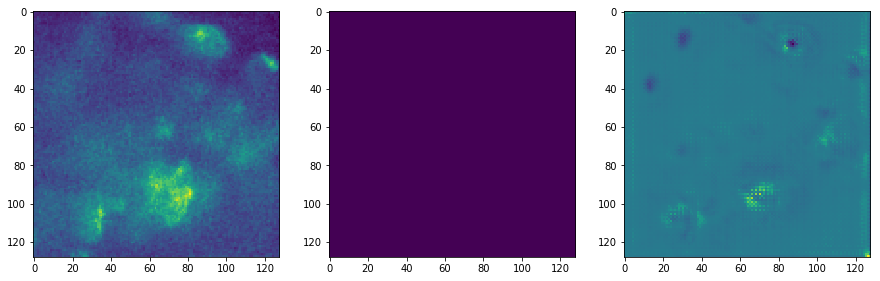

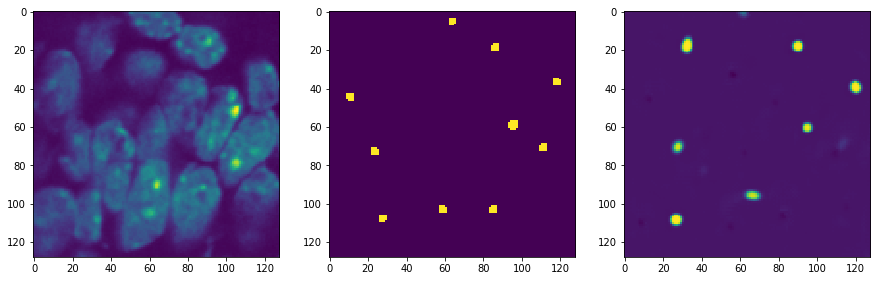

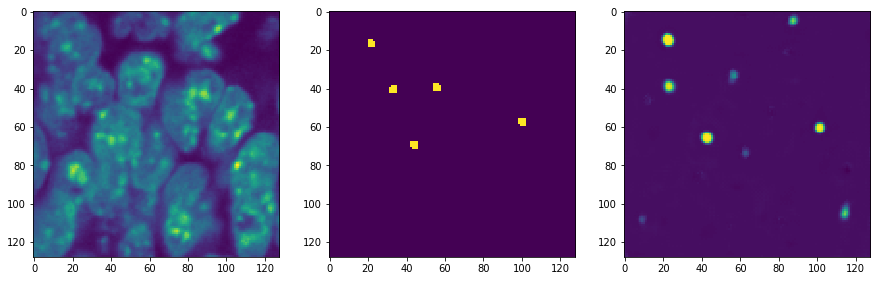

2900
Training loss:  0.0011940126
(3, 8, 128, 128, 1)
Validation loss:  0.008909662


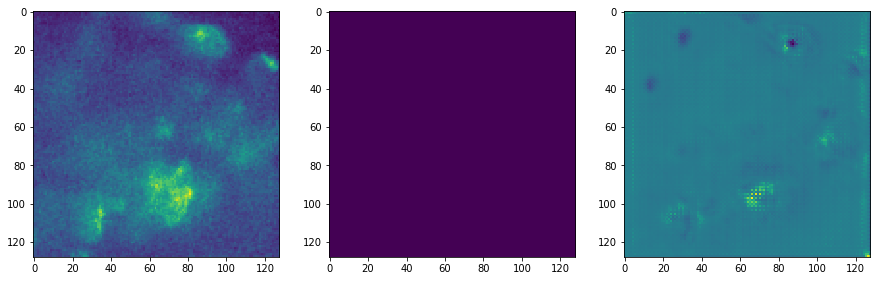

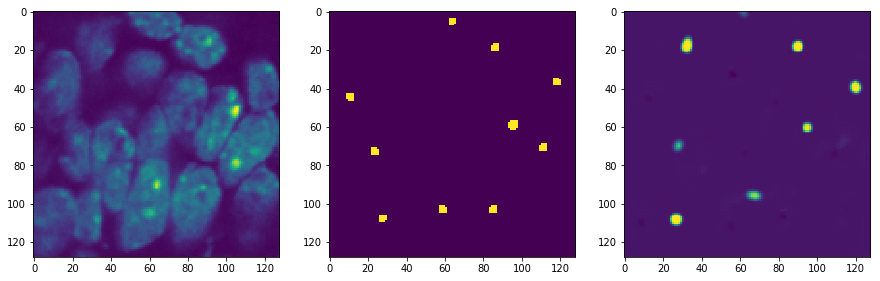

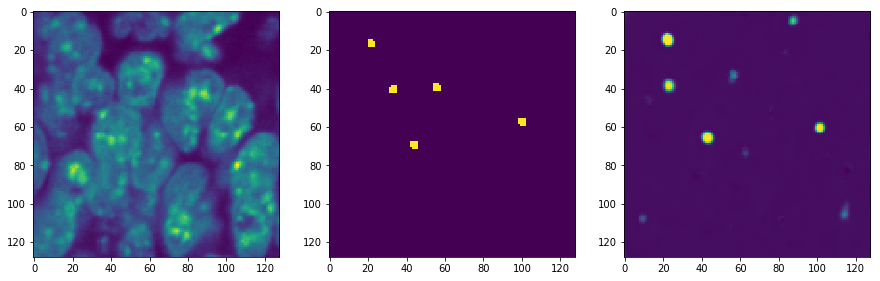

3000
Training loss:  0.0011460895
(3, 8, 128, 128, 1)
Validation loss:  0.009309161


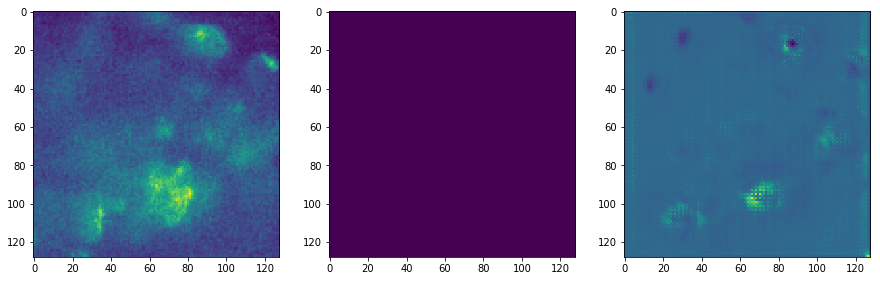

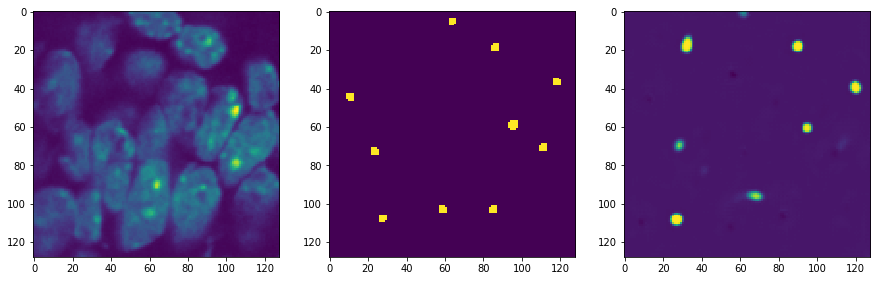

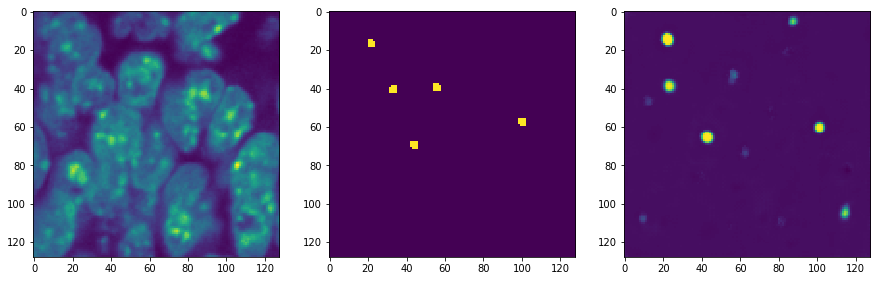

3100
Training loss:  0.0012272068
(3, 8, 128, 128, 1)
Validation loss:  0.008984544


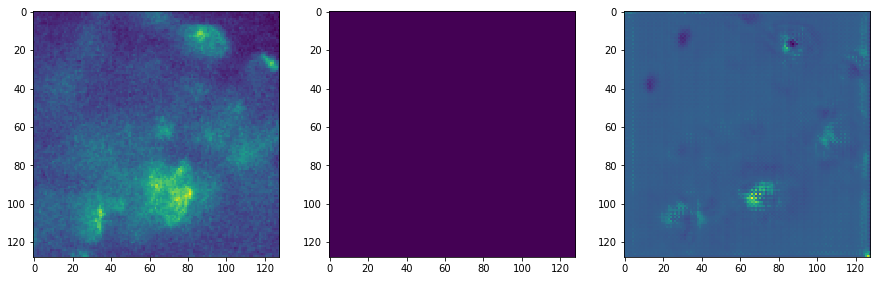

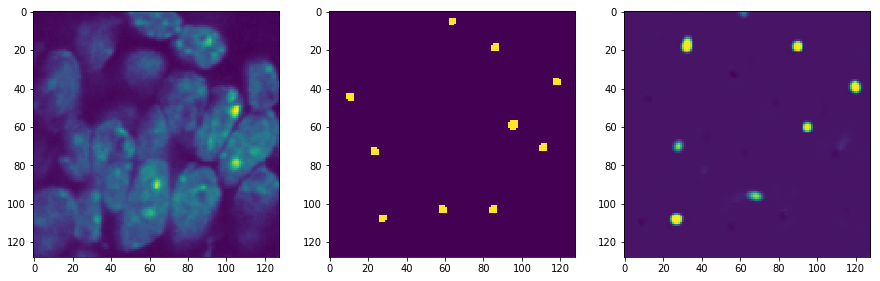

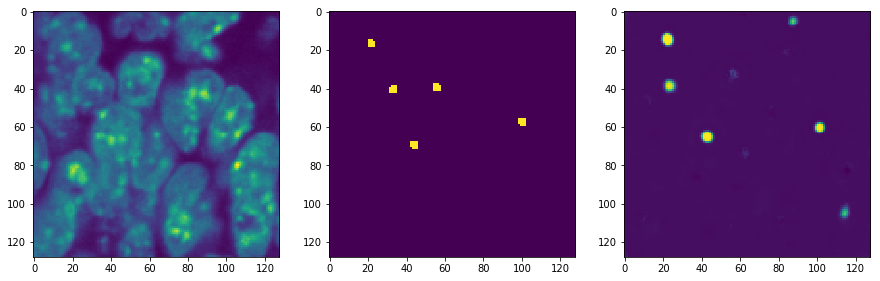

3200
Training loss:  0.0014126763
(3, 8, 128, 128, 1)
Validation loss:  0.008632895


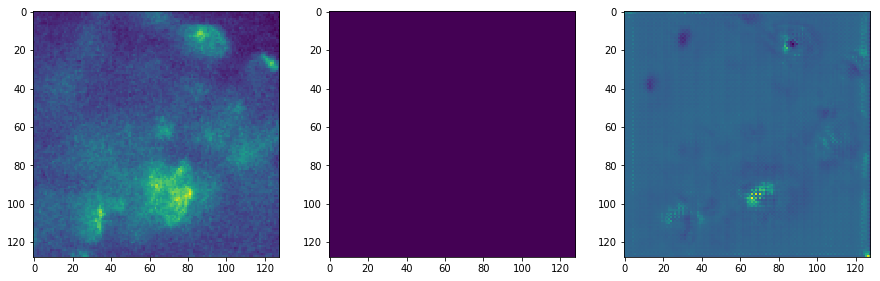

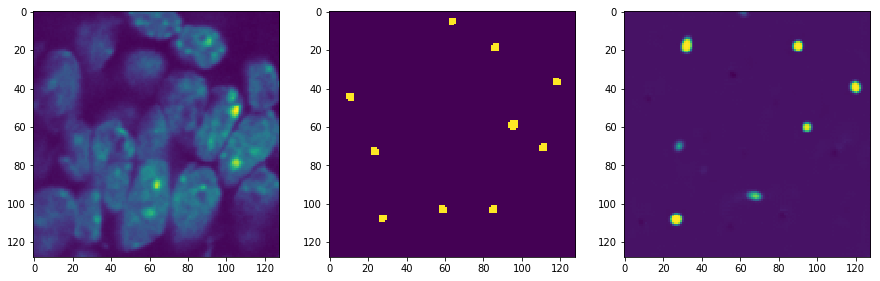

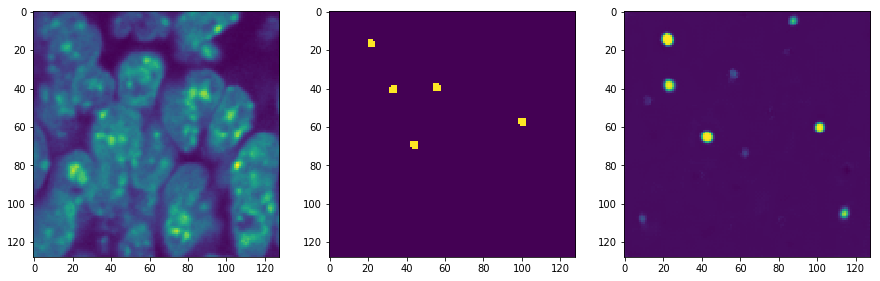

3300
Training loss:  0.0009512106
(3, 8, 128, 128, 1)
Validation loss:  0.008848849


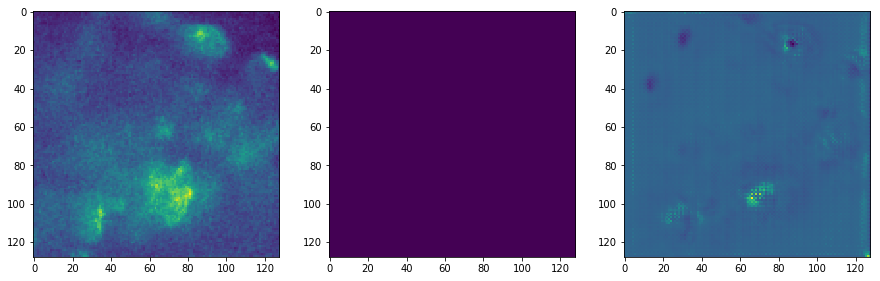

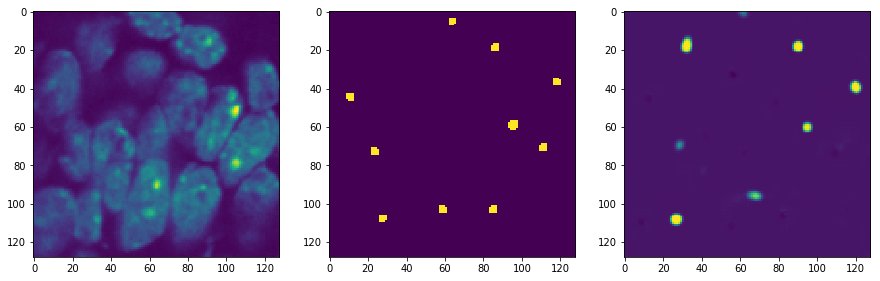

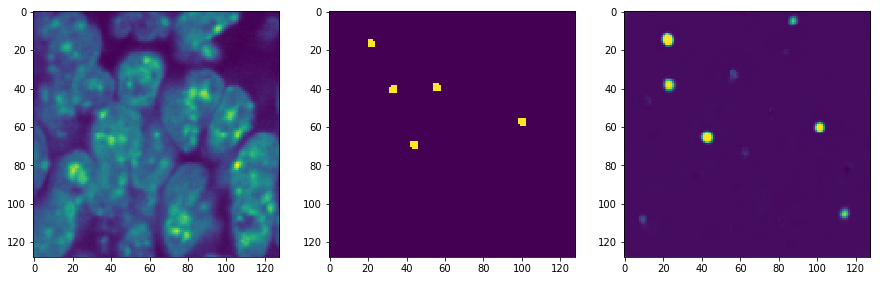

3400
Training loss:  0.0013867373
(3, 8, 128, 128, 1)
Validation loss:  0.008879781


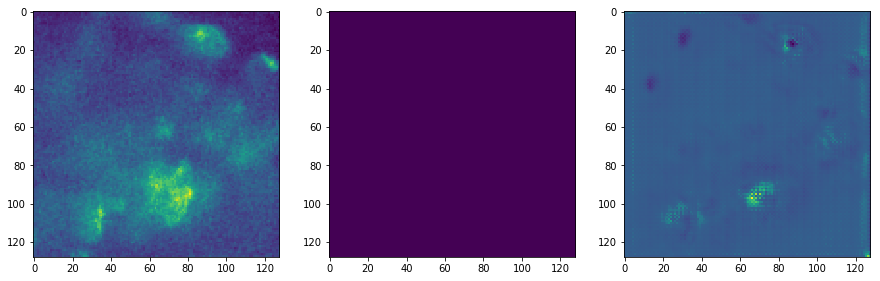

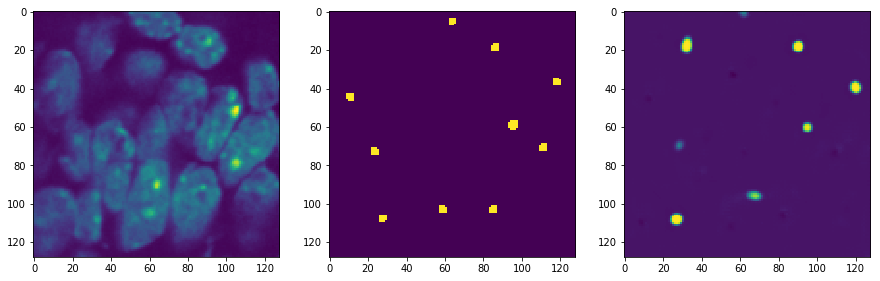

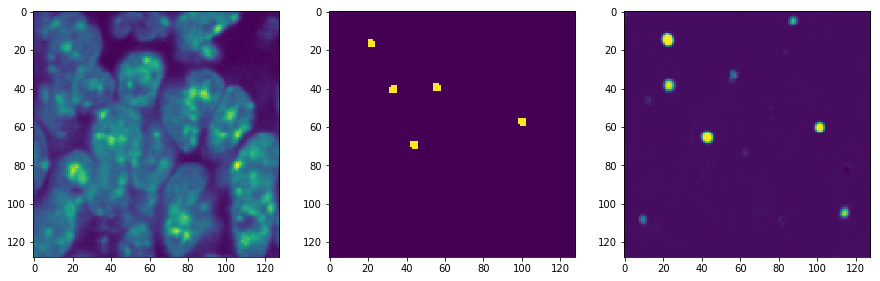

3500
Training loss:  0.0015419616
(3, 8, 128, 128, 1)
Validation loss:  0.008944016


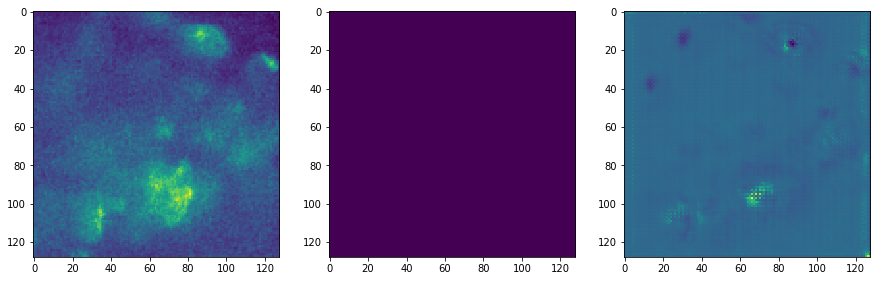

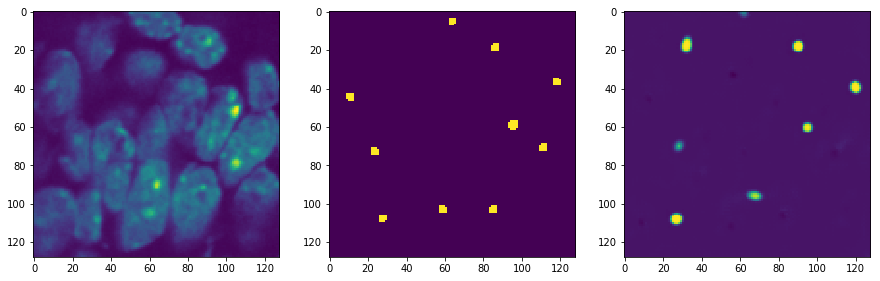

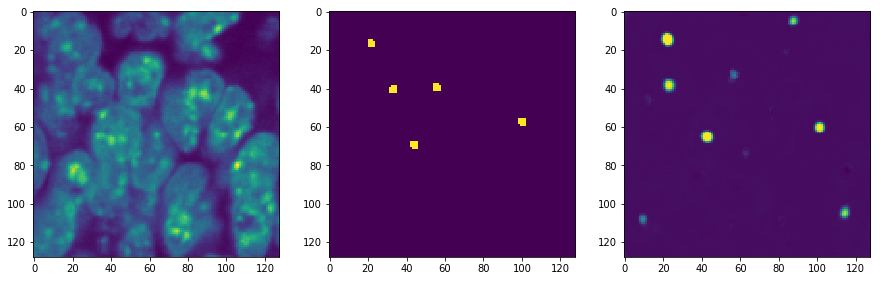

3600
Training loss:  0.0012212748
(3, 8, 128, 128, 1)
Validation loss:  0.009125472


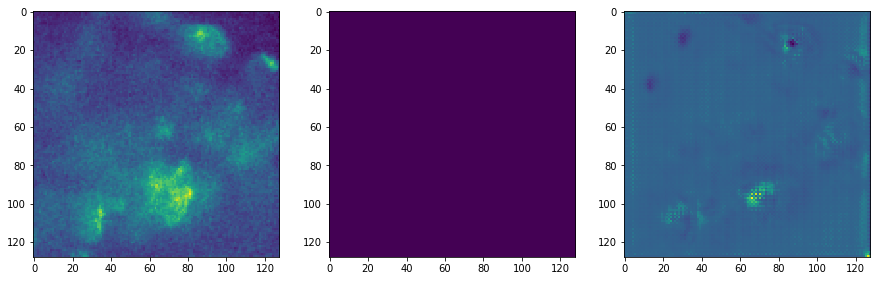

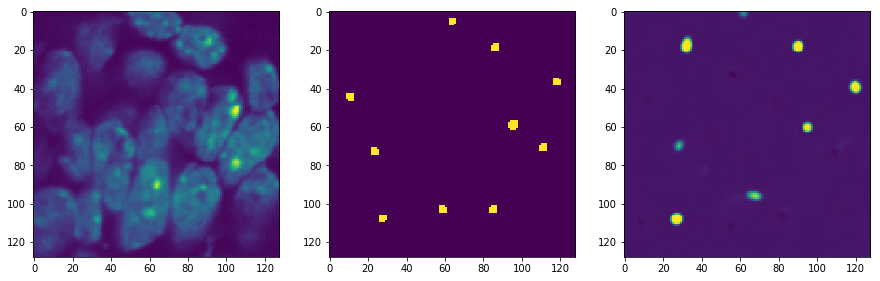

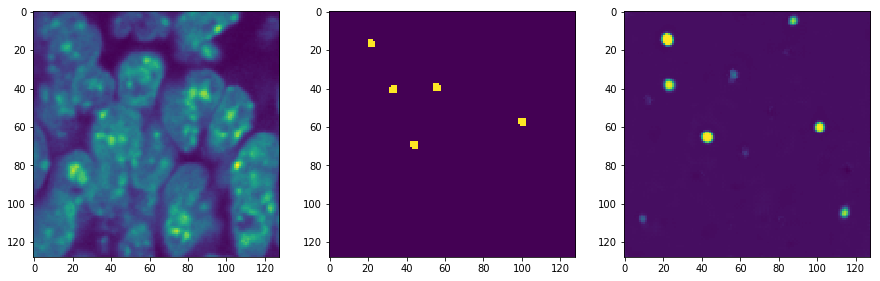

3700
Training loss:  0.0016734083
(3, 8, 128, 128, 1)
Validation loss:  0.00906838


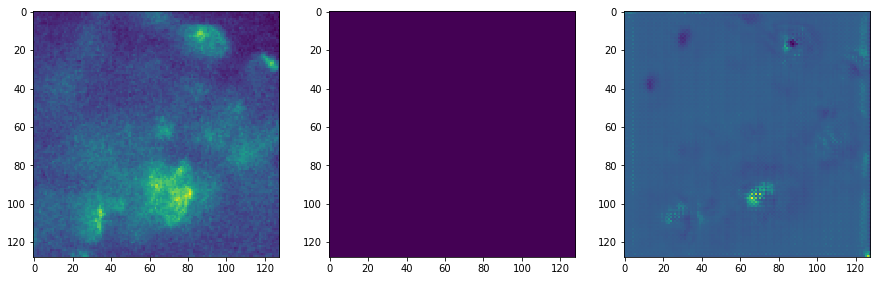

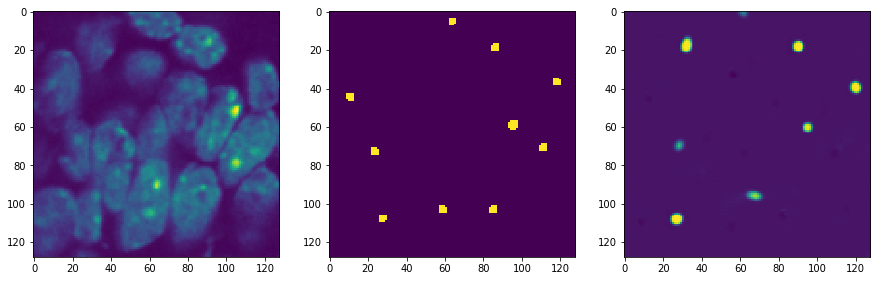

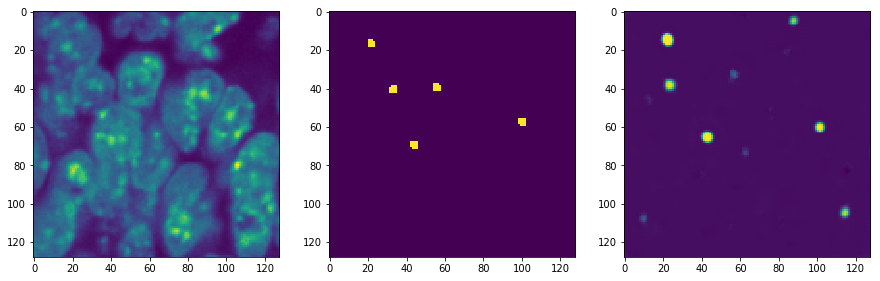

3800
Training loss:  0.0010477438
(3, 8, 128, 128, 1)
Validation loss:  0.008824767


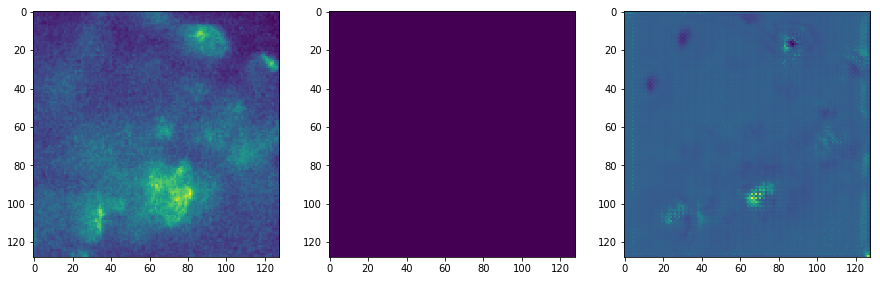

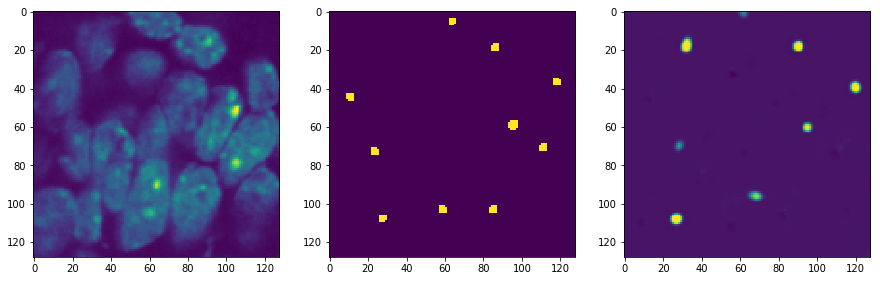

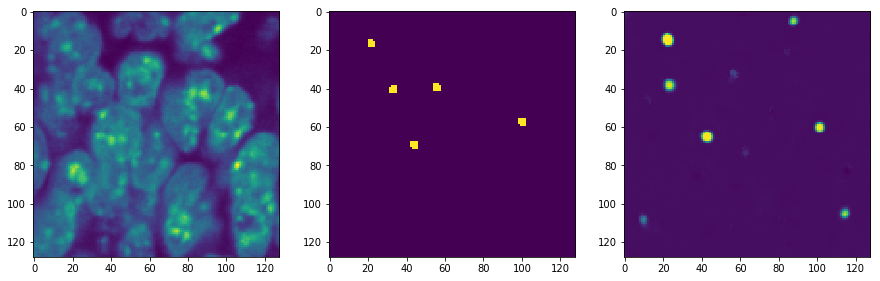

3900
Training loss:  0.0014921046
(3, 8, 128, 128, 1)
Validation loss:  0.008863313


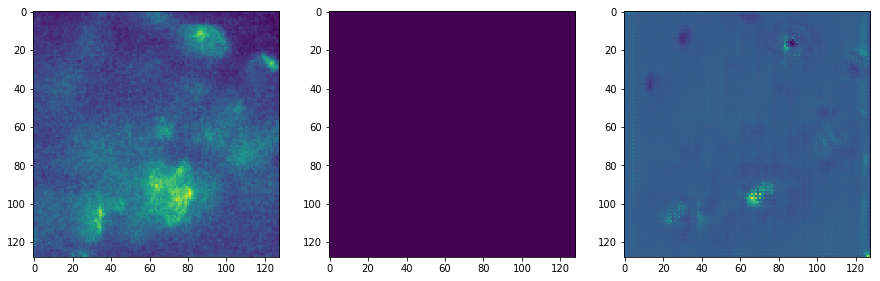

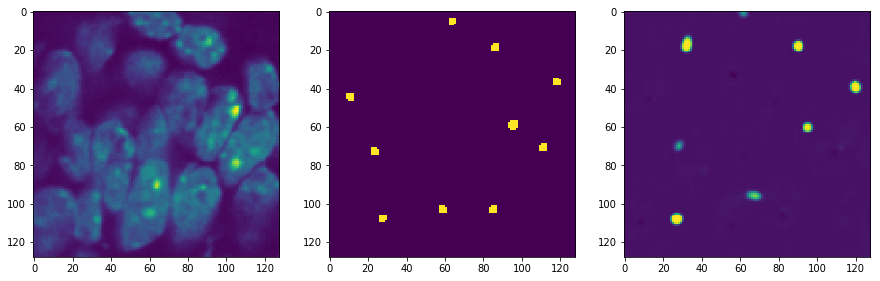

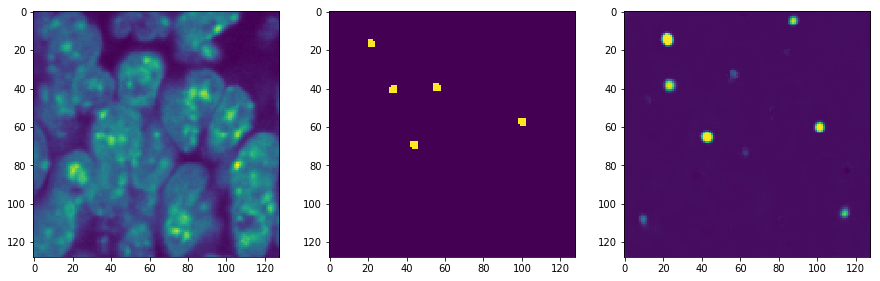

4000
Training loss:  0.0012720007
(3, 8, 128, 128, 1)
Validation loss:  0.009112456


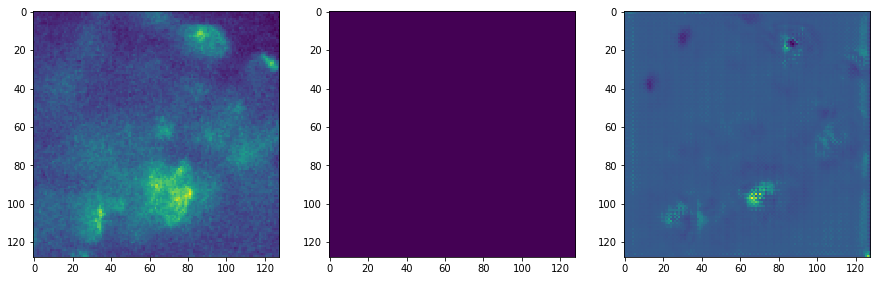

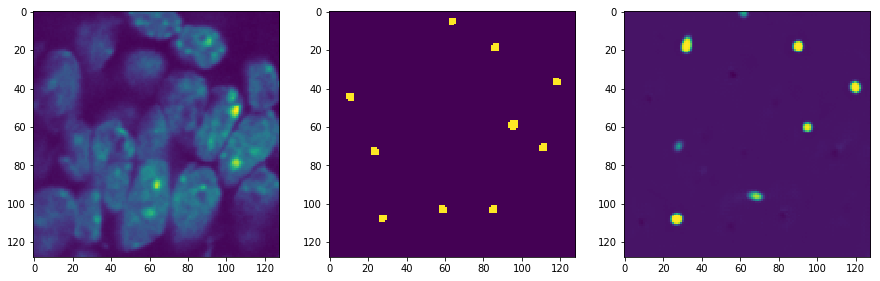

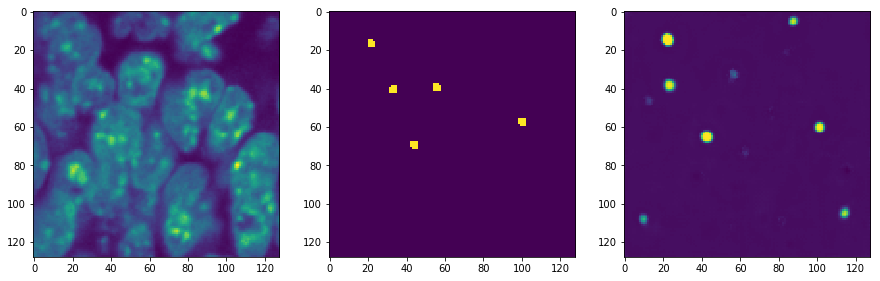

4100
Training loss:  0.00096763414
(3, 8, 128, 128, 1)
Validation loss:  0.009001359


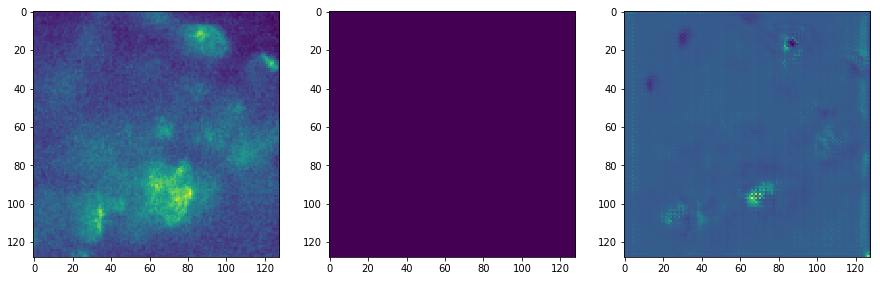

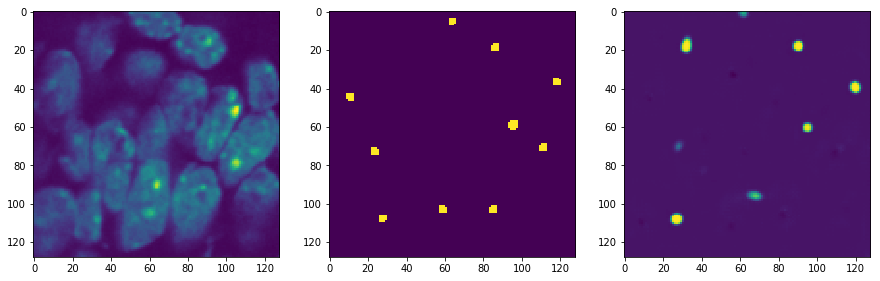

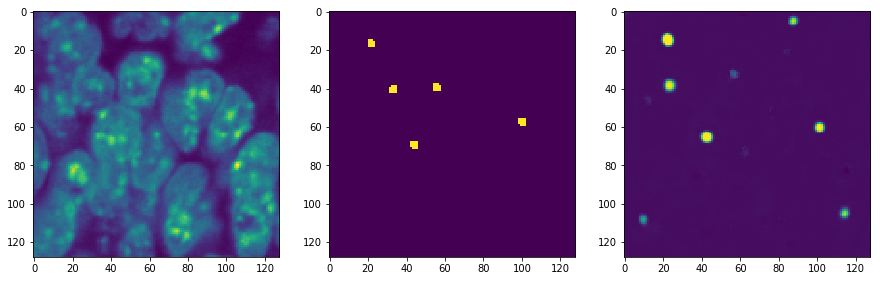

4200
Training loss:  0.0008393208
(3, 8, 128, 128, 1)
Validation loss:  0.008911169


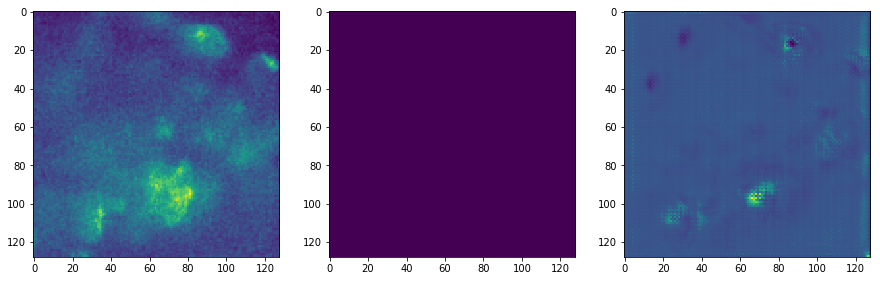

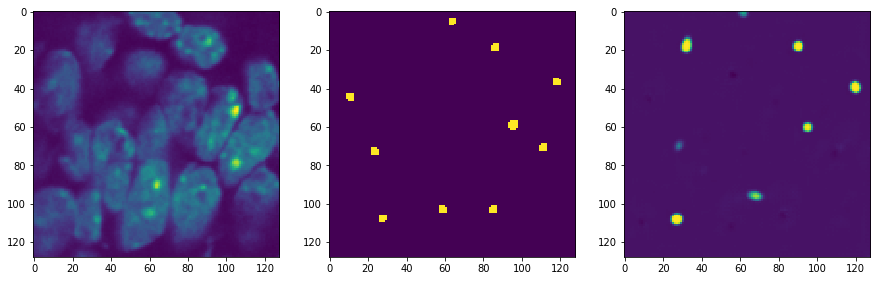

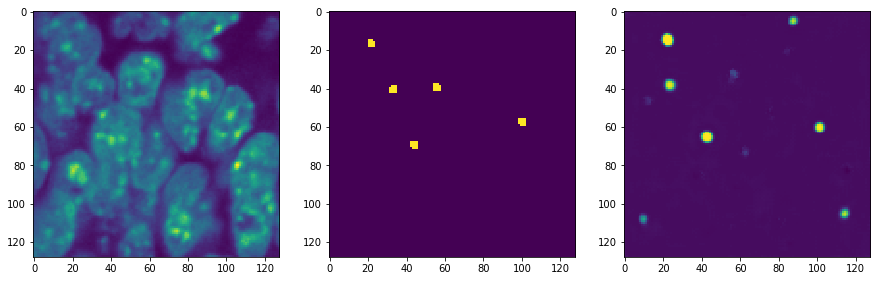

4300
Training loss:  0.0012564413
(3, 8, 128, 128, 1)
Validation loss:  0.009053


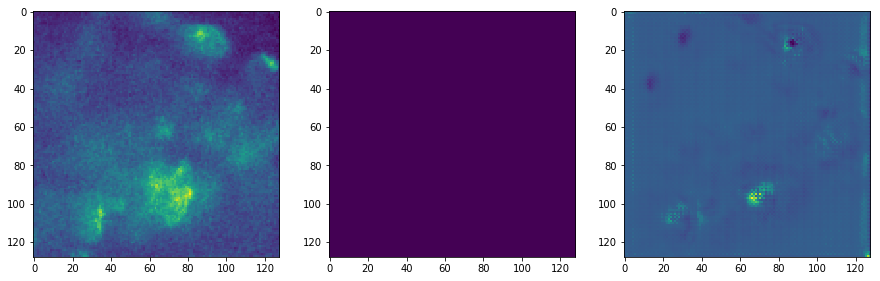

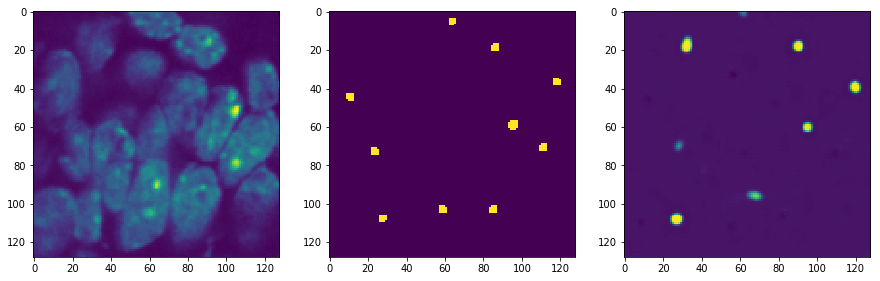

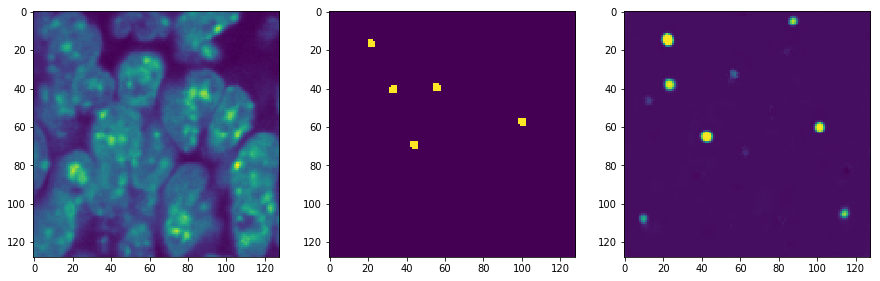

4400
Training loss:  0.0014276109
(3, 8, 128, 128, 1)
Validation loss:  0.009136205


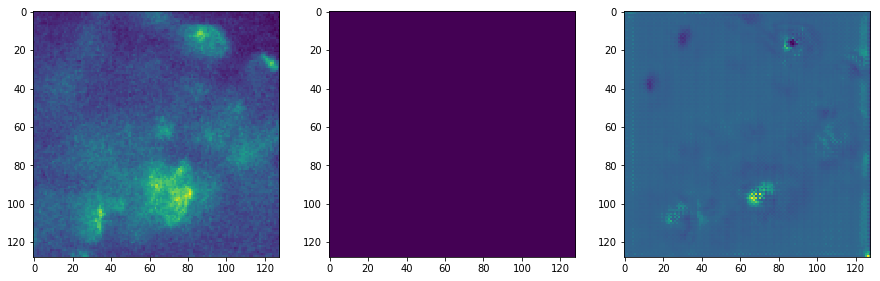

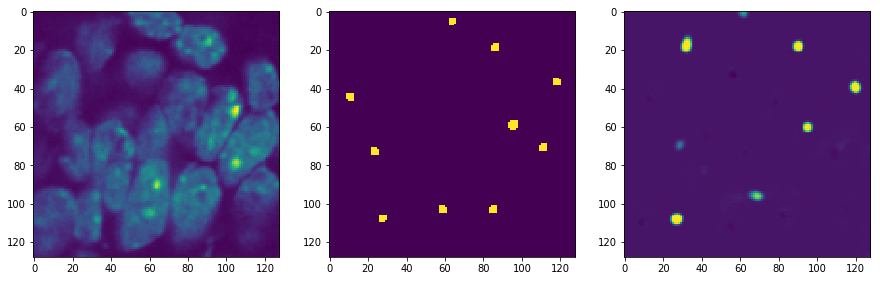

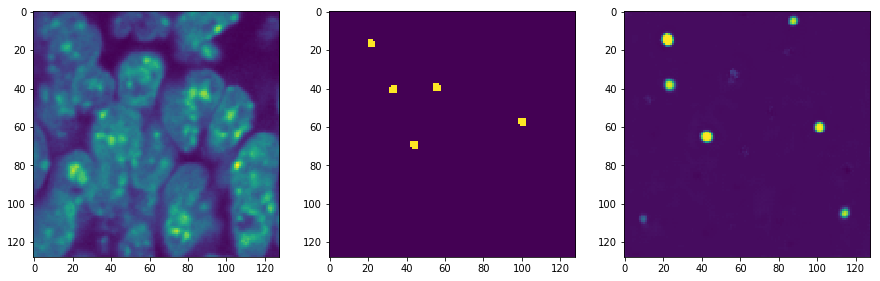

4500
Training loss:  0.0016014199
(3, 8, 128, 128, 1)
Validation loss:  0.008840629


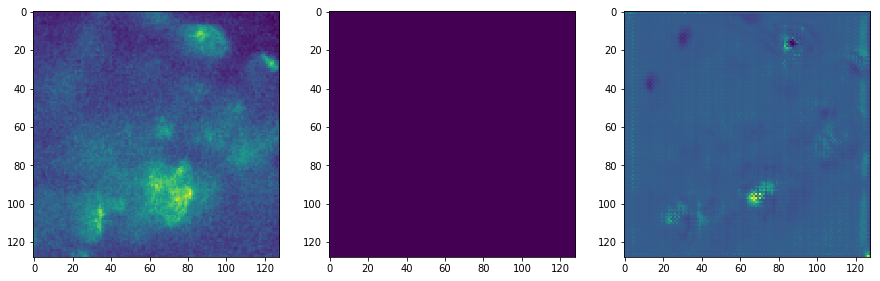

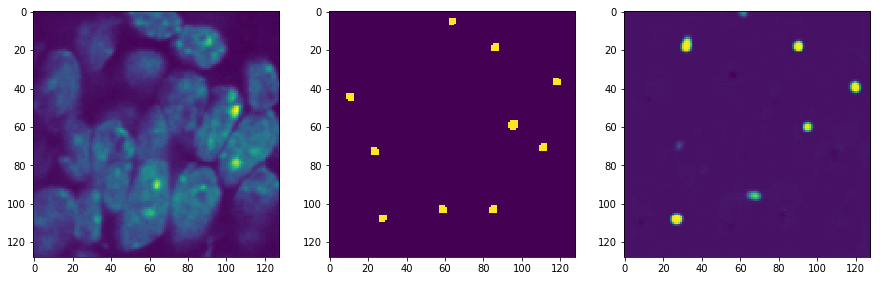

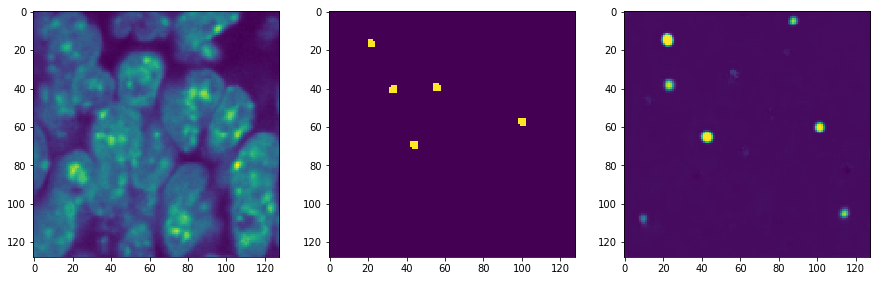

4600
Training loss:  0.00081032224
(3, 8, 128, 128, 1)
Validation loss:  0.009092205


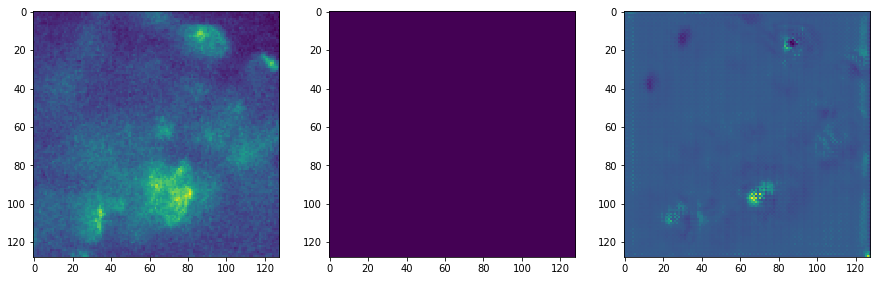

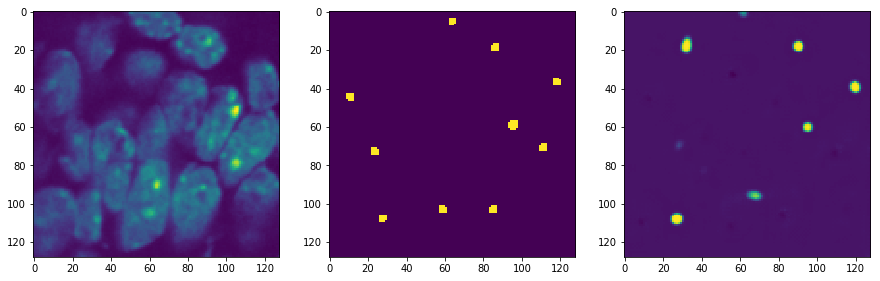

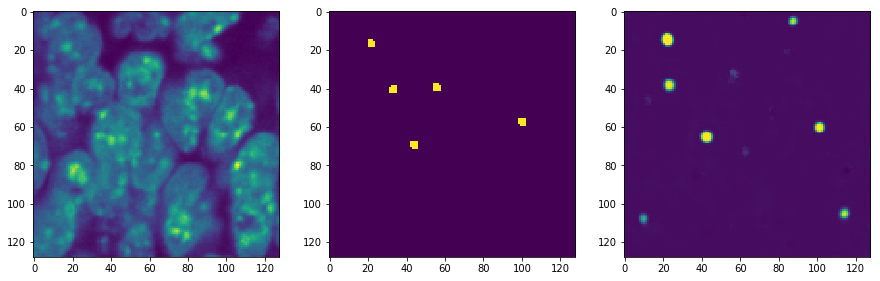

4700
Training loss:  0.001605295
(3, 8, 128, 128, 1)
Validation loss:  0.00879989


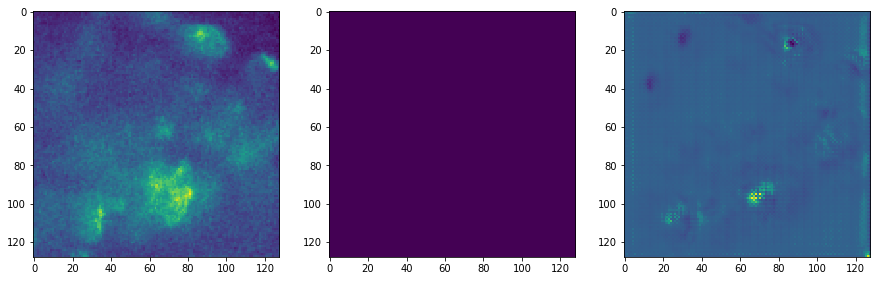

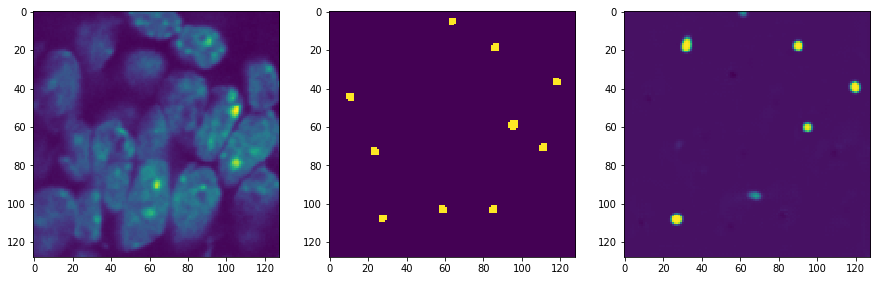

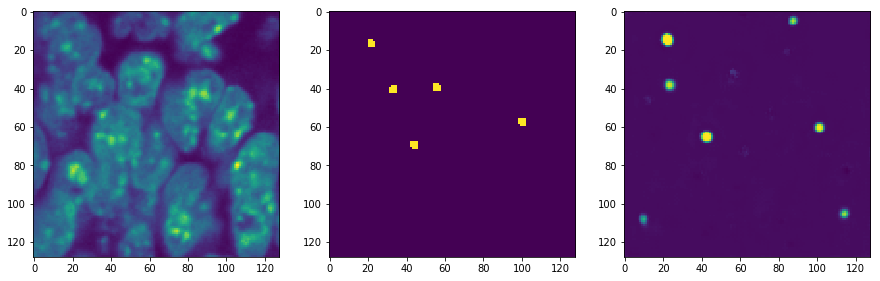

4800
Training loss:  0.0011382571
(3, 8, 128, 128, 1)
Validation loss:  0.008581691


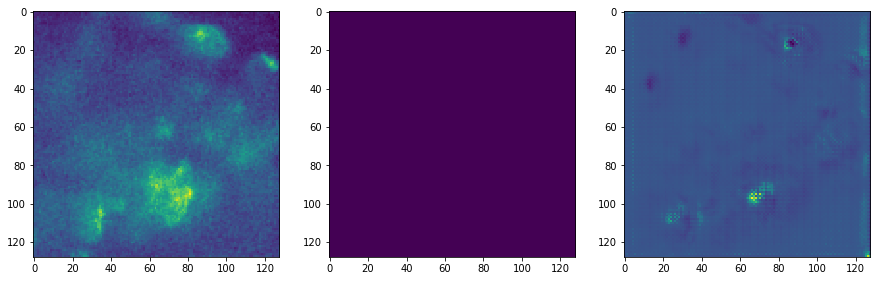

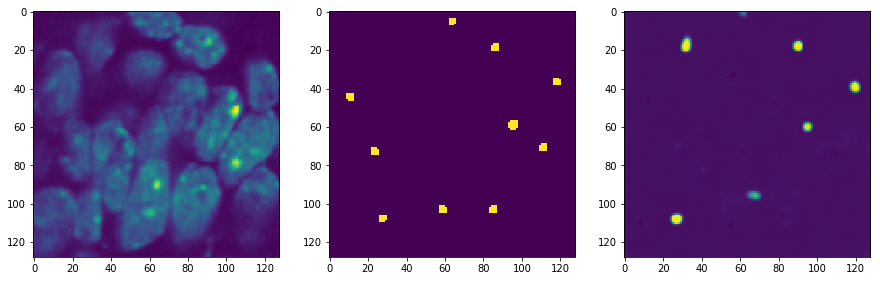

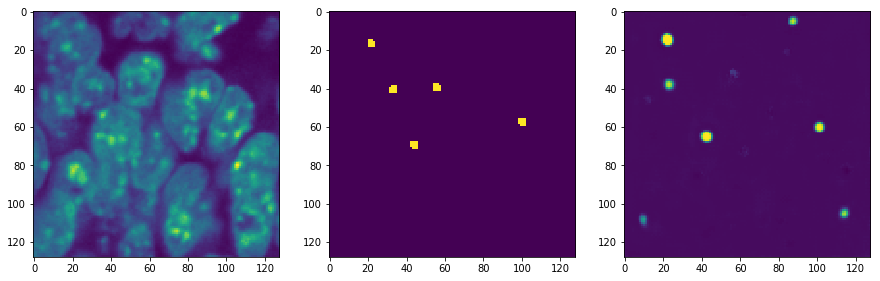

4900
Training loss:  0.0012706476
(3, 8, 128, 128, 1)
Validation loss:  0.009059816


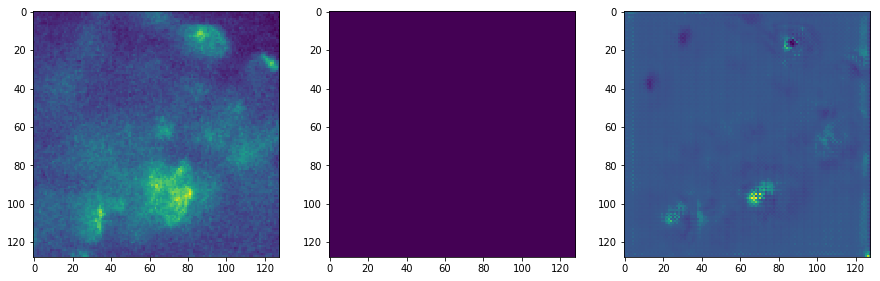

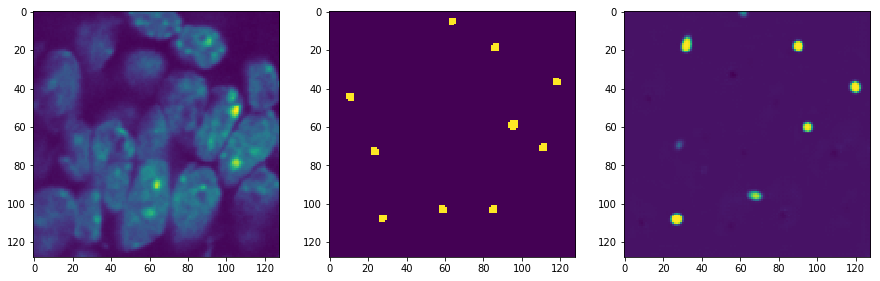

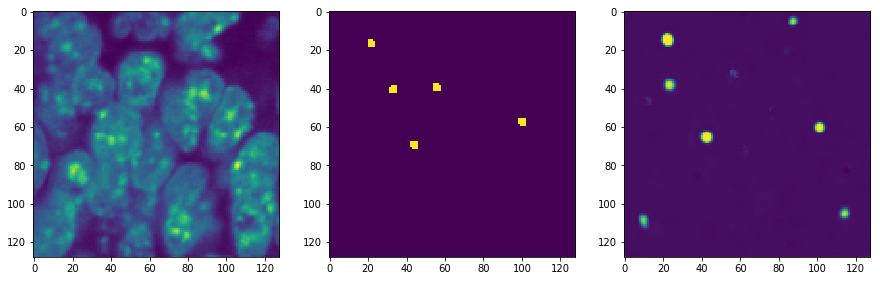

5000
Training loss:  0.0011528446
(3, 8, 128, 128, 1)
Validation loss:  0.008775529


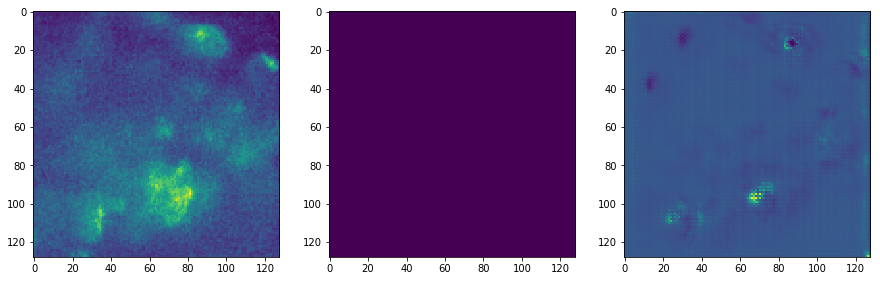

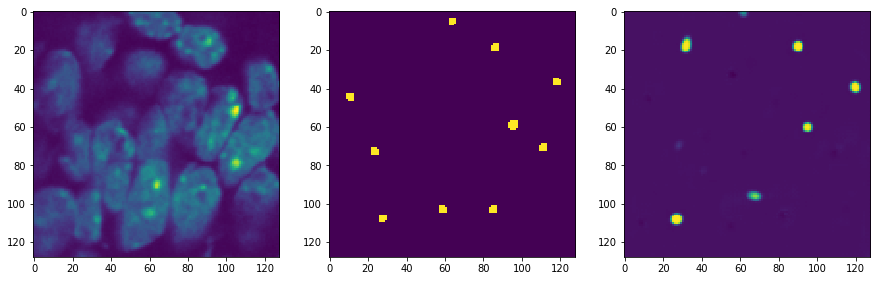

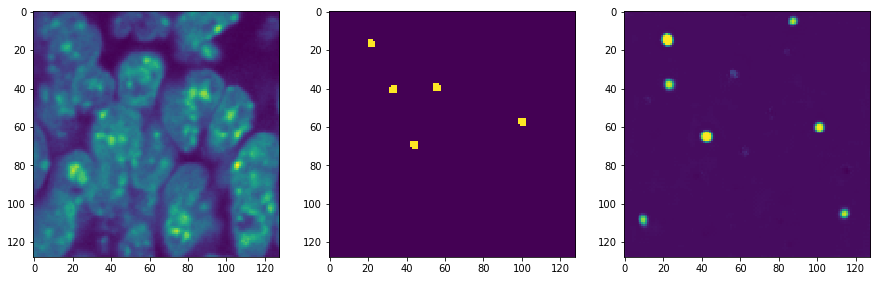

Instructions for updating:
Use standard file APIs to delete files with this prefix.


In [ ]:
shutil.rmtree('./logs/')
tf.set_random_seed(123456)
sess=tf.Session()
sess.run(tf.global_variables_initializer())
saver = tf.train.Saver(max_to_keep=50)
test_writer = tf.summary.FileWriter('./logs/170/test')
current_best=[0,1000000000]


learning_rates=[0.000195, 0.0001, 0.00002, 0.00001]
learning_rate_steps=[500,2500, 3200, 6000]
current_step=0
for lrate, lrs in zip(learning_rates, learning_rate_steps):
    for i in range(current_step, lrs):
        idx=np.random.choice(train_data.shape[0], replace=False, size=[15])
        cur_train=train_data[idx,:,:,:]+0*np.random.uniform(-0.03, 0.03, 1)
        cur_truth=train_truth[idx,:,:]
        _, results, losses=sess.run([train_op,  probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})
        #train_writer.add_summary(summary, i)
        if (i%100==0):
            print(i)
            print("Training loss: ",losses)
            #idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
            idx=range(0,3, 1)
            sub_validation_data=validation_data[idx, :,:,:]
            sub_validation_truth=validation_truth[idx, :,:]
            summary, results, losses=sess.run([merge, probs, loss], feed_dict={x:sub_validation_data, y:sub_validation_truth})
            test_writer.add_summary(summary, i)
            print(results.shape)
            print("Validation loss: ",losses)
            for ti in range (0,3):
                utils.plot_3x1(sub_validation_data[ti,4,:,:,0], sub_validation_truth[ti,4,:,:,0], results[ti,4,:,:,0])
                plt.show()
            saver.save(sess, data+'NewModels/Model'+str(i))
    current_step=lrs

In [21]:
tf.train.write_graph(sess.graph_def, 'Data/NewModels/', 'saved_3100.pb', as_text=False)#1800

'Data/NewModels/saved_3100.pb'

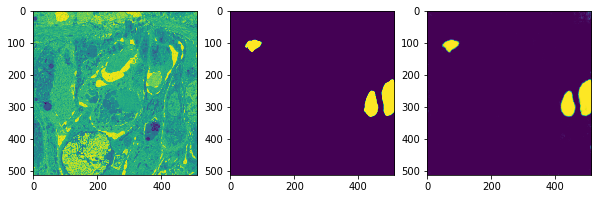

In [31]:
idx=np.random.choice(validation_data.shape[0], replace=False, size=[25])
cur_train=train_data[idx,:,:,:]
cur_truth=train_truth[idx,:,:]
results, losses=sess.run([probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})

ids=4
utils.plot_3x1(cur_train[ids,:,:,0], cur_truth[ids,:,:,0], results[ids,:,:,0])

# Process new datafiles using trained network

Load the network that works best

In [7]:
saver = tf.train.Saver()
sess=tf.Session()
sess.run(tf.global_variables_initializer())

data_model=data+'NewModels/Model'+str(1800)
saver.restore(sess,data_model)

Instructions for updating:
Use standard file APIs to check for files with this prefix.
INFO:tensorflow:Restoring parameters from /home/ubuntu/Data/NewModels/Model1800


Function for processing a file

In [25]:
def process_file(sess, file_path, save_dir):
    file_data=skimage.external.tifffile.imread(file_path)
    #if (len(file_data.shape)==4):
    file_data=np.reshape(file_data, [file_data.shape[0], 8, x_dim, x_dim, 1])
    #else:
    #    file_data=np.swapaxes(np.swapaxes(file_data,2,3), 3,4)
    inference_data=file_data
    
    #true_test2_data=true_test2_data/np.std(true_test2_data)*0.02
    #true_test2_data=true_test2_data-np.mean(true_test2_data)+0.55
    #v1true_test2_data=(true_test2_data-.578)/.138+0.5
    inference_data=(inference_data-mean)/std+0.5

    channels=inference_data.shape[4]
    num_images=inference_data.shape[0]
    output=np.zeros([num_images,8,x_dim,x_dim,2])
    process_batch_size=20
    print('Starting')
    for t in range(0,num_images,process_batch_size):
        endrng=np.min((t+process_batch_size,num_images))
        inference_batch_data=inference_data[t:(t+process_batch_size), :,:,:]
        results=sess.run(probs, feed_dict={x:inference_batch_data})
        output[t:(t+process_batch_size),:,:,:,0]=inference_batch_data[:,:,:,:,0]
        output[t:(t+process_batch_size),:,:,:,1]=results[:,:,:,:,0]
    print('Done')
    inference_data=0
    output[:,:,:,:,0]=file_data[:,:,:,:,0]
    output=np.swapaxes(np.swapaxes(output,4,3),3,2)
    np.place(output, output<0, 0)
    file_name=file_path.split('/')[-1]
    print(output.dtype)
    skimage.external.tifffile.imsave(save_dir+file_name, output.astype('float32'), imagej=True)
    print('Written')
    return output


In [28]:
test=process_file(sess, '/home/ubuntu/Data/D_windowed.tif', '/home/ubuntu/Data/Output/')

Starting
Done
float64
Written


In [29]:
test.shape

(45, 8, 2, 128, 128)

In [14]:
import glob
for f in glob.glob('/n/projects/smc/public/STN/19-6-3b_ali_level_fullsize/DeepLearn/Data/*.tif'):
    output=process_file(sess, f, data+'v1/Output/')

Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
D

Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float

float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Wr

Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
St

Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
D

Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float64
Written
Starting
Done
float

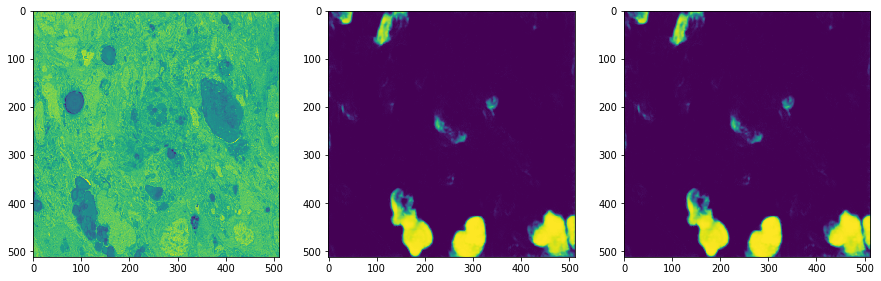

In [24]:
ids=4
utils.plot_3x1(output[ids,0,:,:], output[ids,1,:,:], output[ids,1,:,:])

# Retrain using new data and best old model

In [49]:
if os.path.isdir(data+'NewModels/'):
    os.rename(data+'NewModels/', data+'OldModels/')

In [50]:
both=skimage.external.tifffile.imread(data+'Training_retrain_RotShift.tif')
both=np.swapaxes(np.swapaxes(both,1,2), 2,3)

x_dim=both.shape[1]
y_dim=both.shape[2]
channels=both.shape[3]-2

In [51]:
file=open(data+'Network.txt')
base_scaler=int(file.readline())
baseline_noise=float(file.readline())
x_dim=int(file.readline())
mean=float(file.readline())
std=float(file.readline())
model=int(file.readline())
channels=int(file.readline())
file.close()

In [52]:
train_data=both[:,:,:,0:-2]/655350.0
train_truth=both[:,:,:,[-2,-1]]

train_data=(train_data-mean)/(std*1)+0.5
train_truth[np.where(train_truth>0.1)]=1

validation=skimage.external.tifffile.imread(data+'Validation_annotated.tif')
validation=np.swapaxes(np.swapaxes(validation,1,2), 2,3)

validation_data=validation[:,:,:,0:-2]/655350.0
validation_data=(validation_data-mean)/(std*1)+0.5

validation_truth=validation[:,:,:,[-2,-1]]
validation_truth[np.where(validation_truth>0.1)]=1


In [56]:
saver = tf.train.Saver()
sess=tf.Session()
sess.run(tf.global_variables_initializer())

#data_model=data+'OldModels/Model'+str(model)
data_model=data+'OldModels/Model'+str(1500)
saver.restore(sess,data_model)

0
Training loss:  0.01055294
(3, 512, 512, 2)
Validation loss:  0.005736654


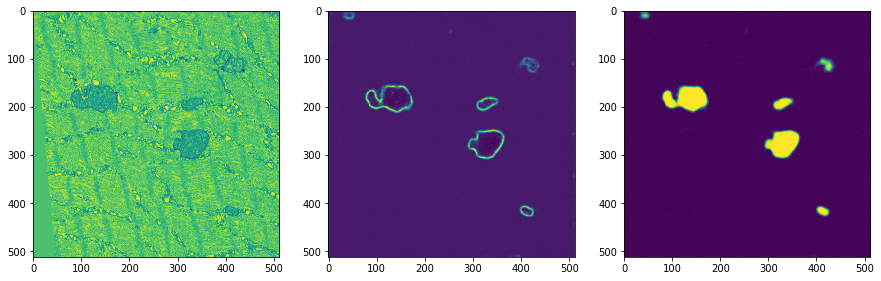

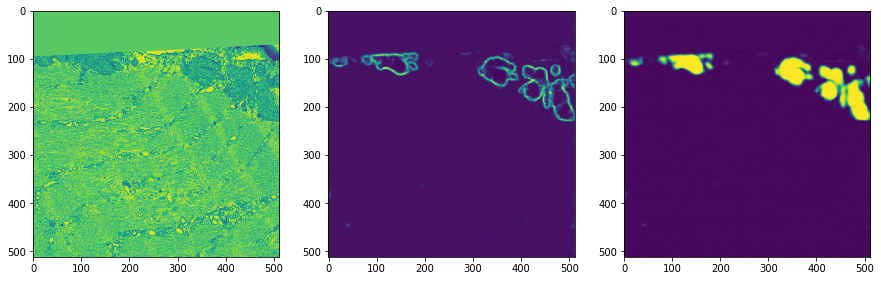

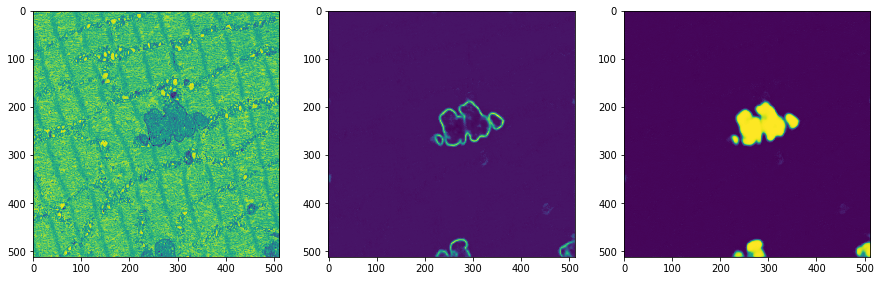

100
Training loss:  0.00900529
(3, 512, 512, 2)
Validation loss:  0.005215116


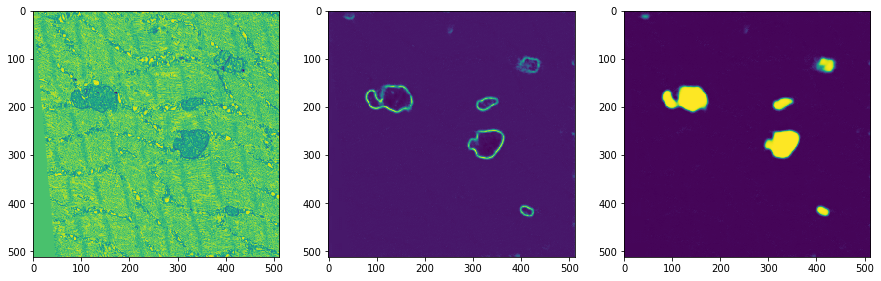

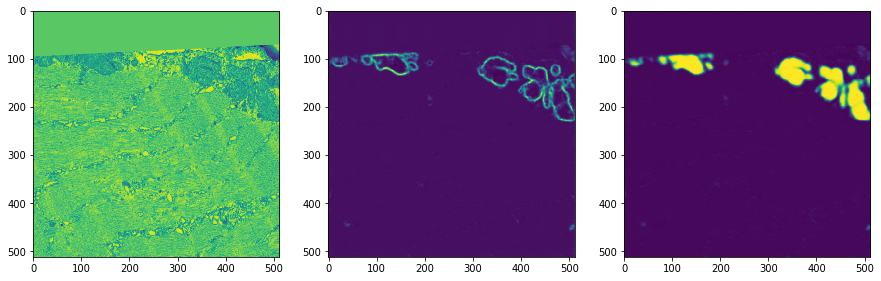

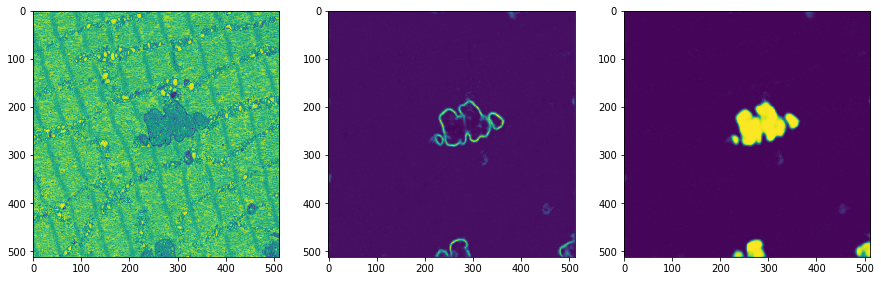

200
Training loss:  0.007782866
(3, 512, 512, 2)
Validation loss:  0.005301018


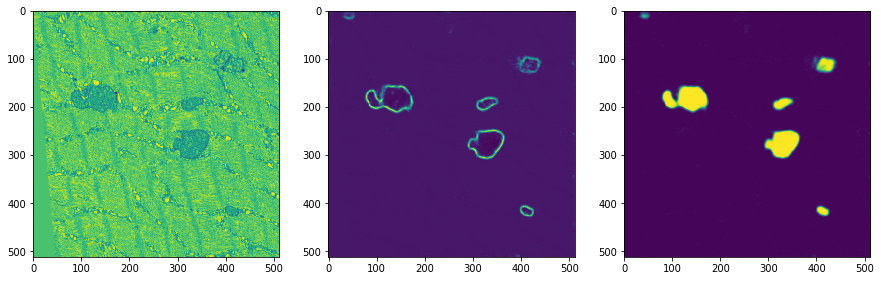

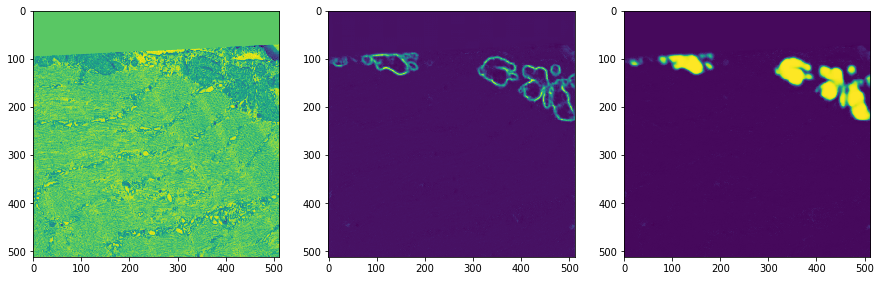

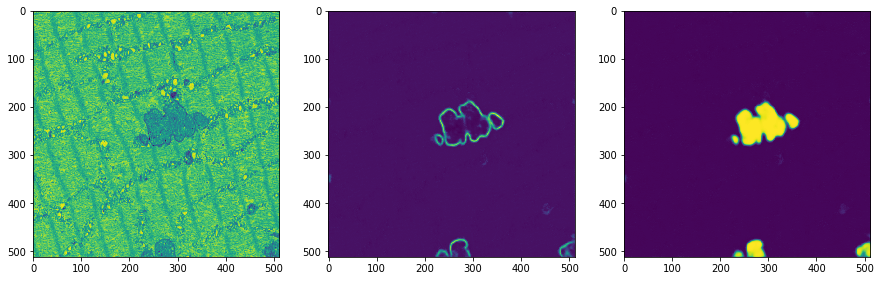

300
Training loss:  0.0063638096
(3, 512, 512, 2)
Validation loss:  0.005252032


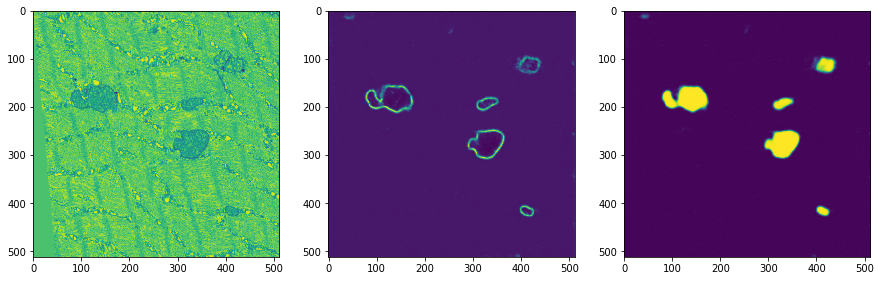

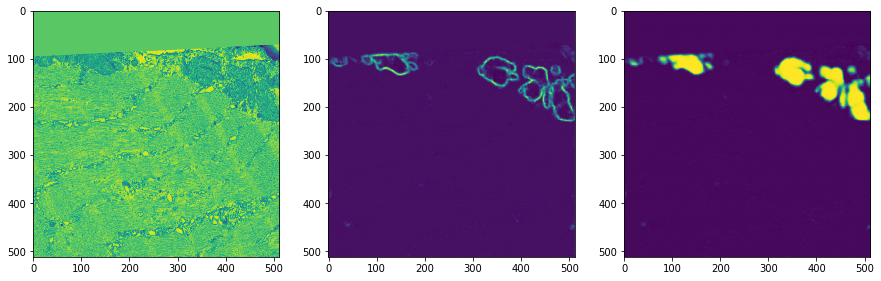

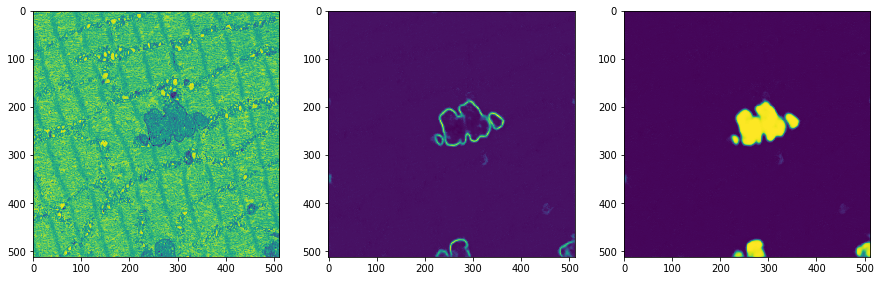

400
Training loss:  0.011437751
(3, 512, 512, 2)
Validation loss:  0.005232986


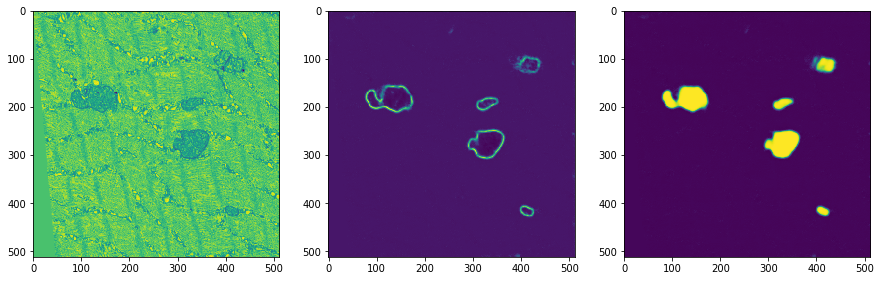

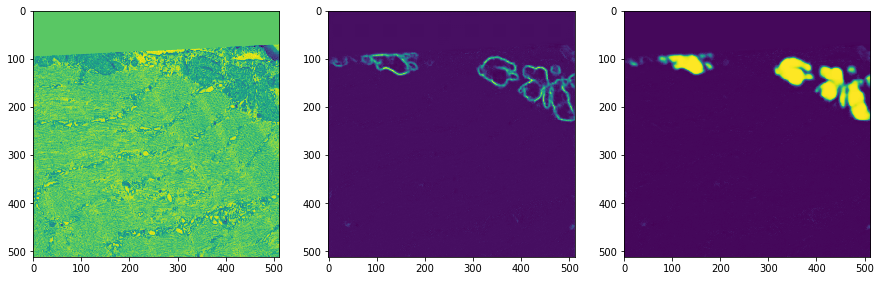

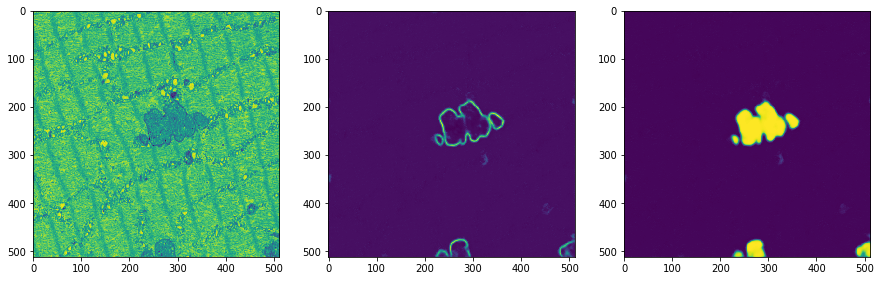

500
Training loss:  0.008659465
(3, 512, 512, 2)
Validation loss:  0.005132097


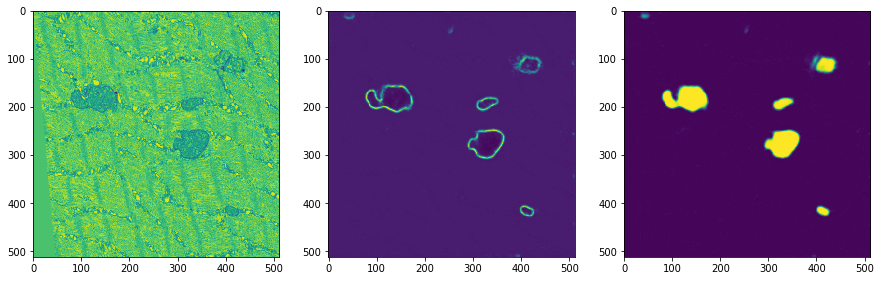

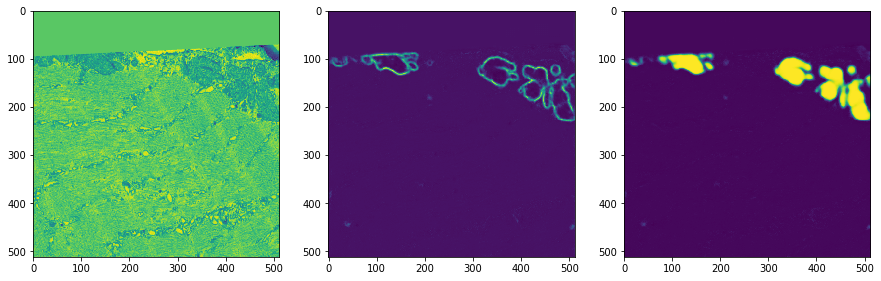

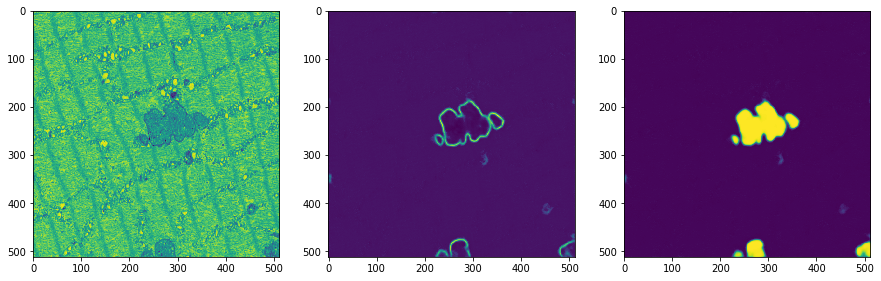

600
Training loss:  0.007433119
(3, 512, 512, 2)
Validation loss:  0.005175729


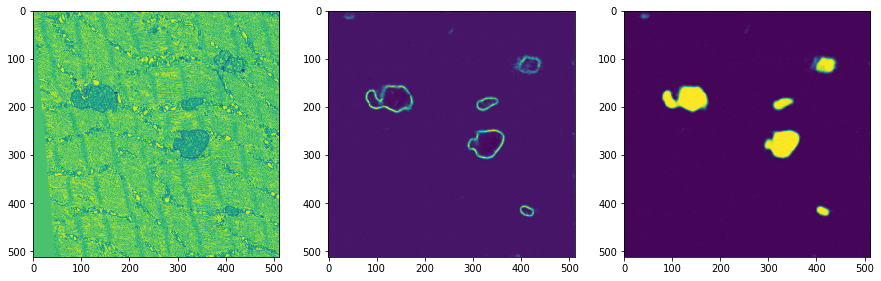

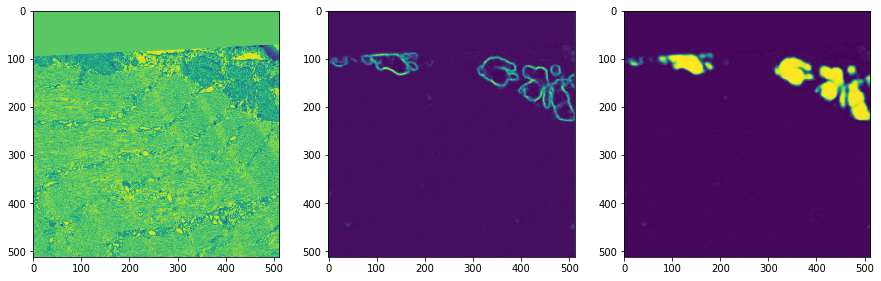

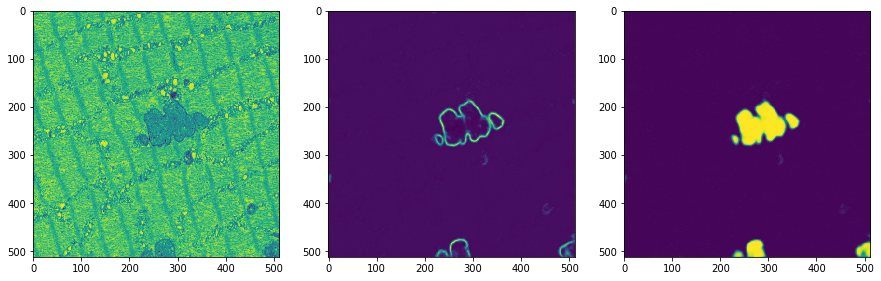

700
Training loss:  0.008370575
(3, 512, 512, 2)
Validation loss:  0.005141972


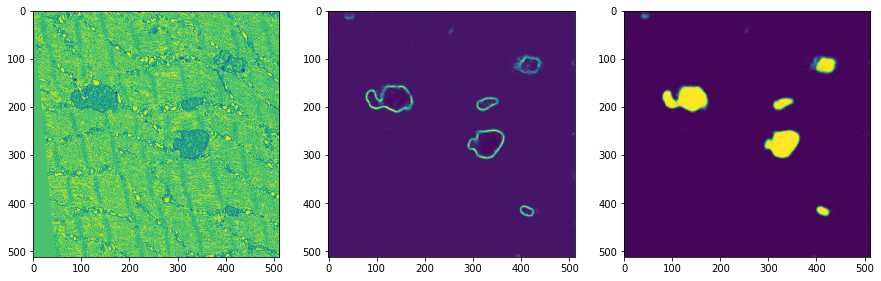

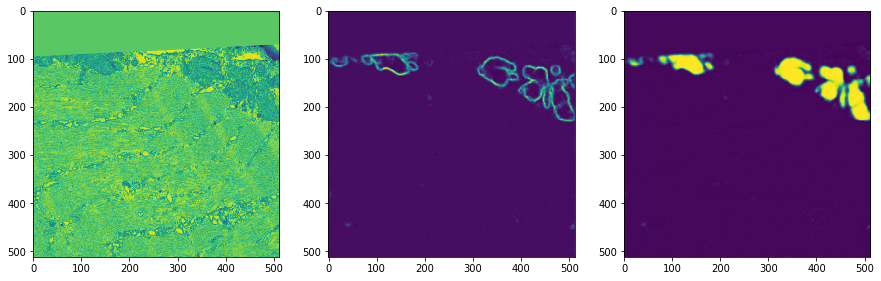

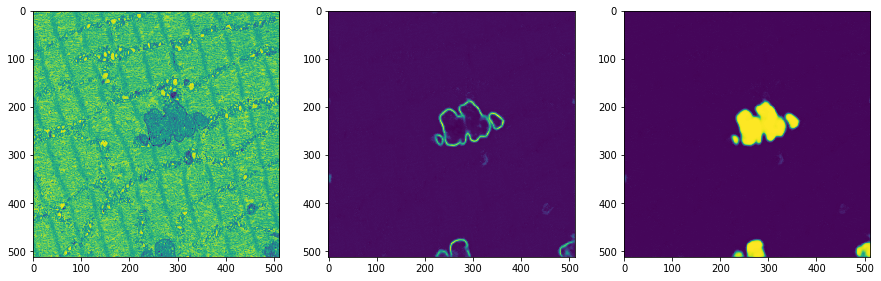

800
Training loss:  0.010153889
(3, 512, 512, 2)
Validation loss:  0.005244376


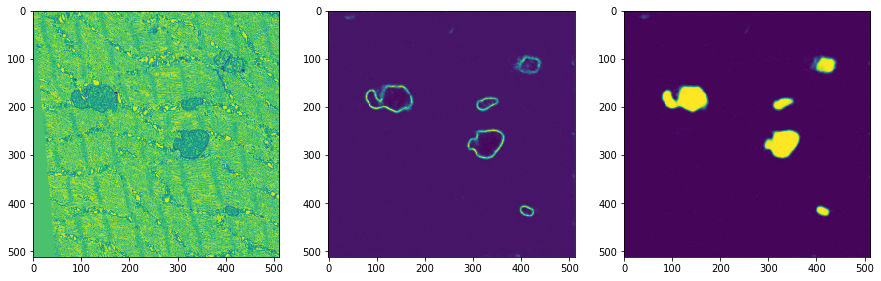

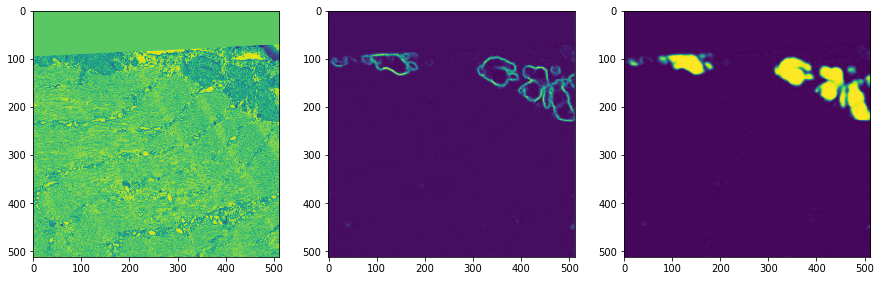

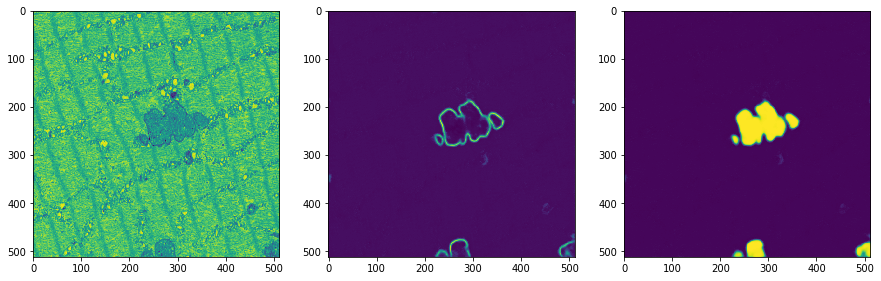

900
Training loss:  0.00825664
(3, 512, 512, 2)
Validation loss:  0.005039207


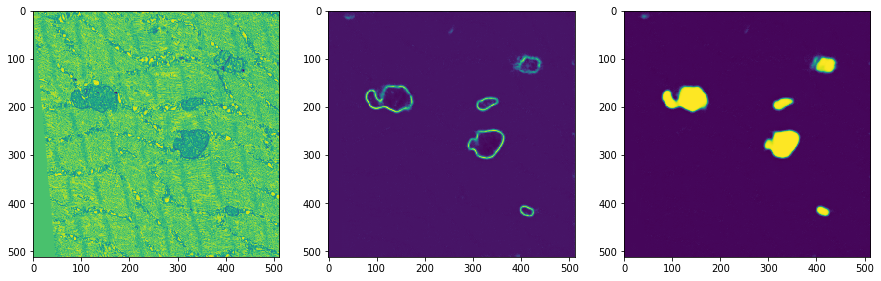

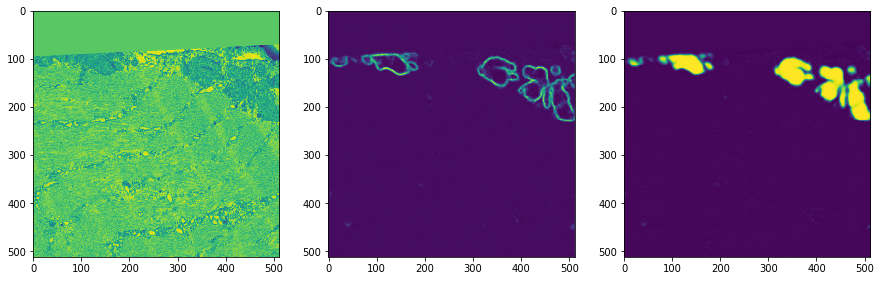

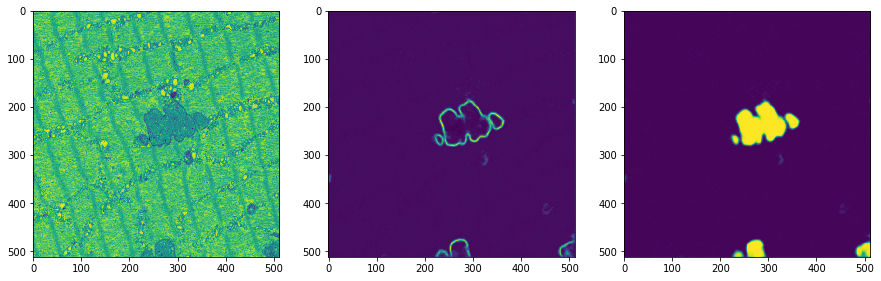

1000
Training loss:  0.009528242
(3, 512, 512, 2)
Validation loss:  0.0051275715


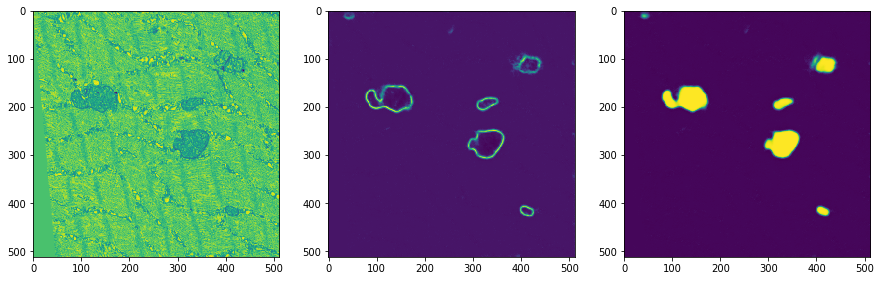

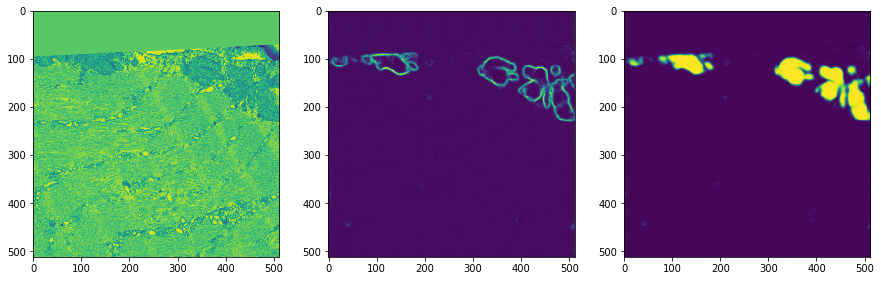

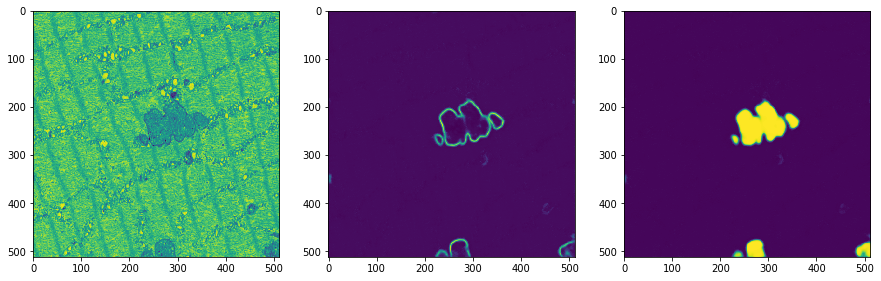

1100
Training loss:  0.0057472433
(3, 512, 512, 2)
Validation loss:  0.005115318


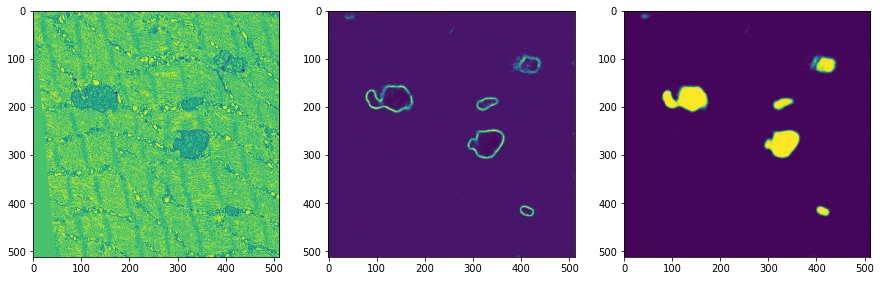

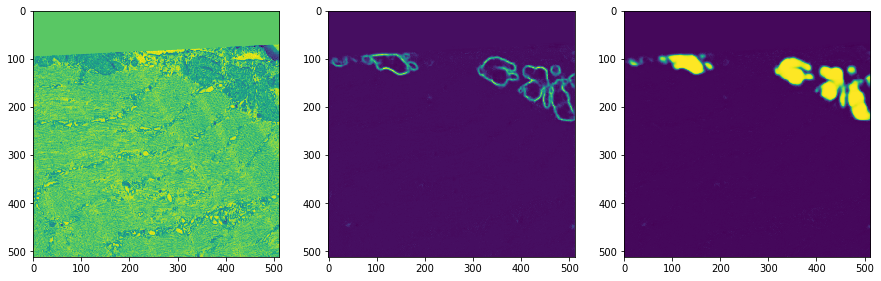

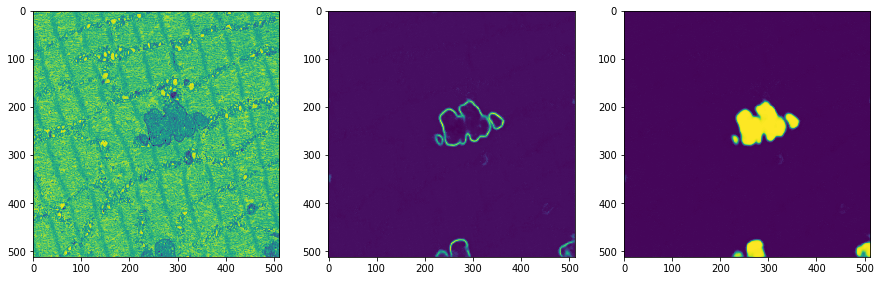

1200
Training loss:  0.0063980236
(3, 512, 512, 2)
Validation loss:  0.0049404763


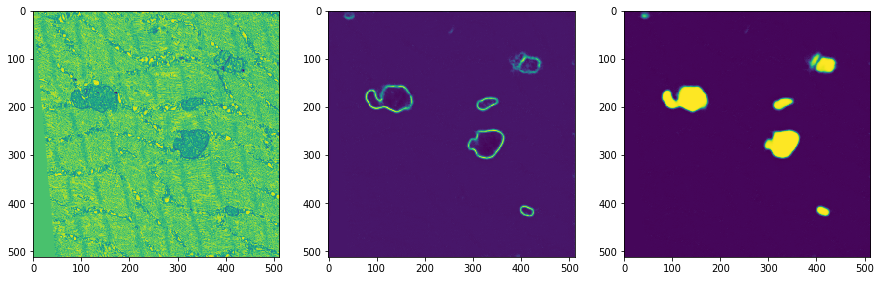

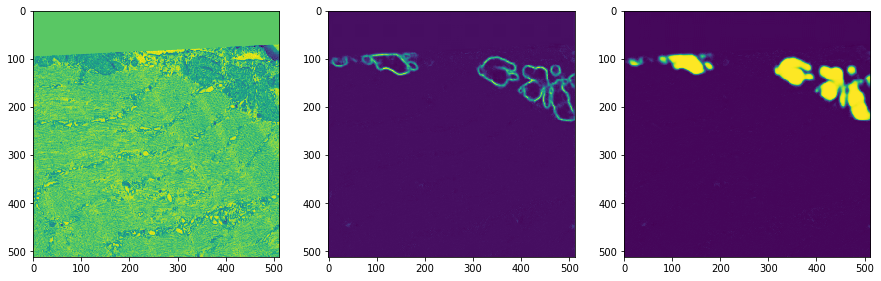

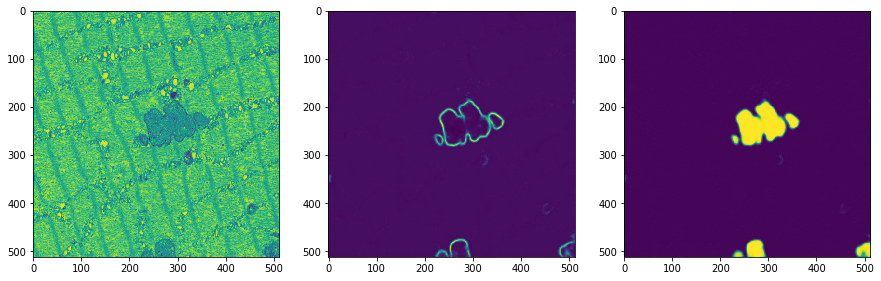

1300
Training loss:  0.009417358
(3, 512, 512, 2)
Validation loss:  0.0048163314


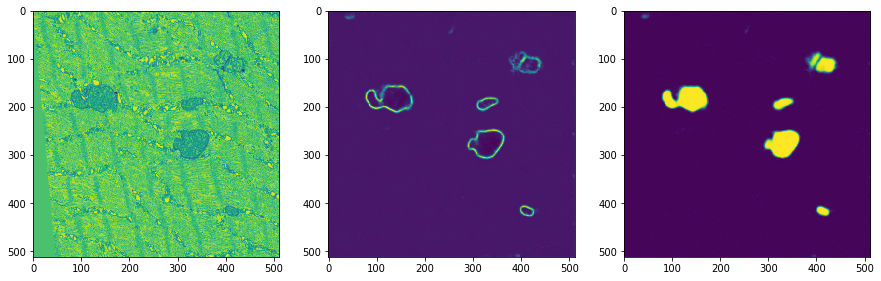

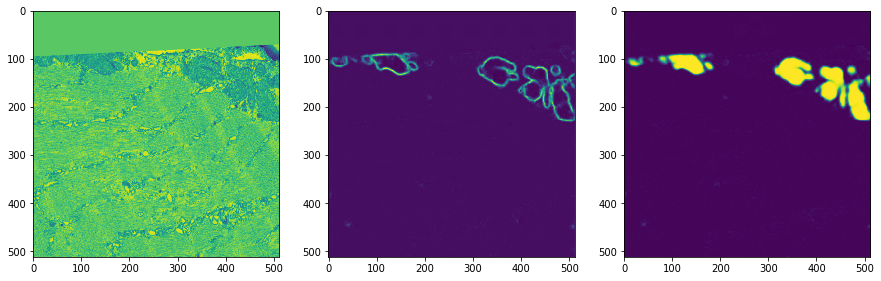

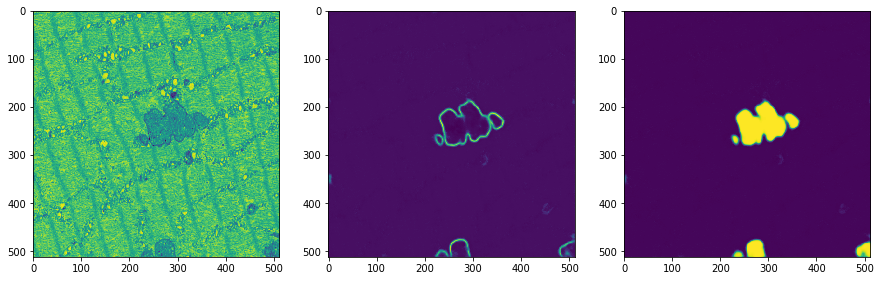

1400
Training loss:  0.008767967
(3, 512, 512, 2)
Validation loss:  0.004719852


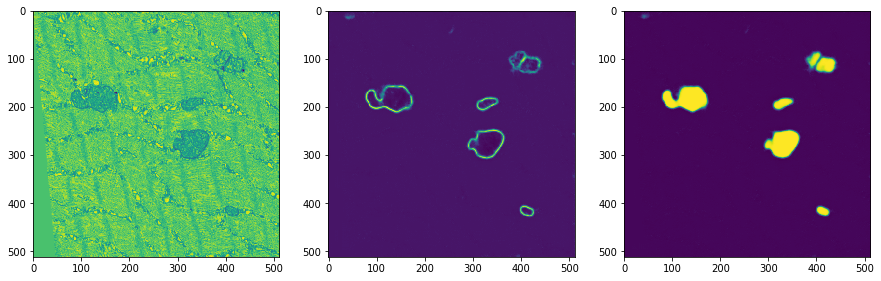

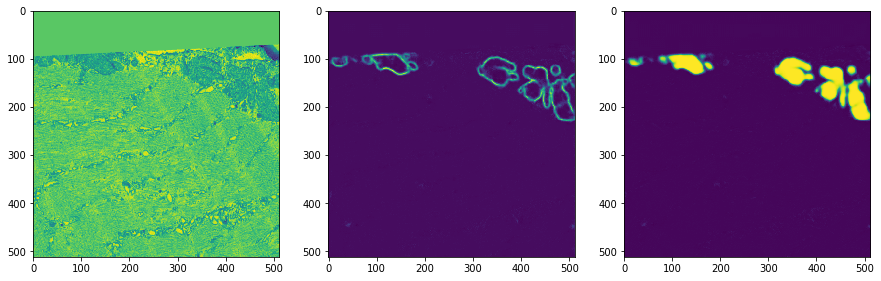

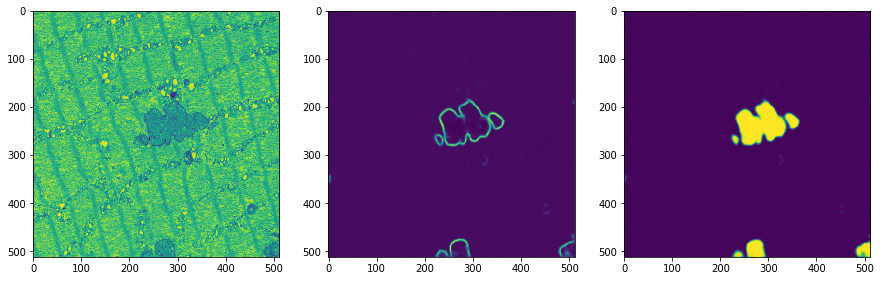

1500
Training loss:  0.008230918
(3, 512, 512, 2)
Validation loss:  0.004679288


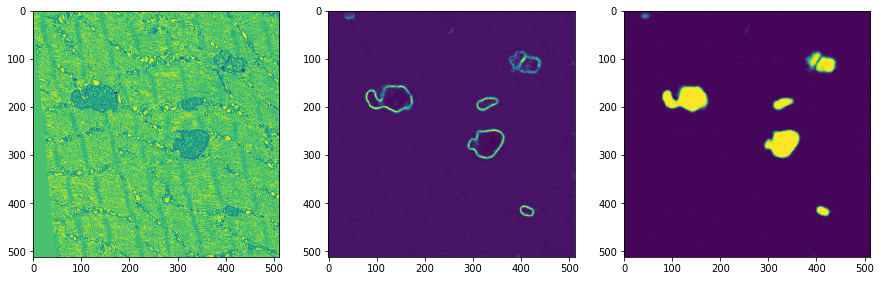

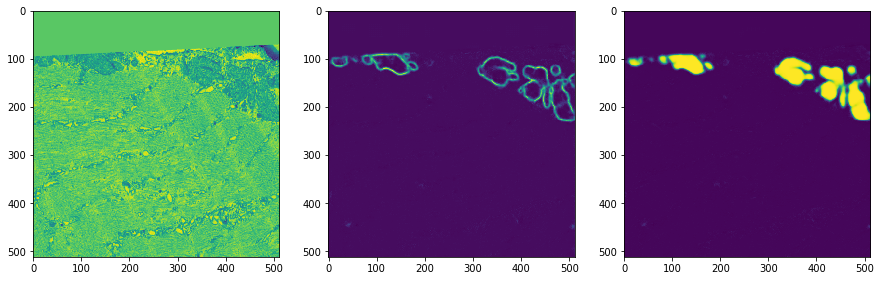

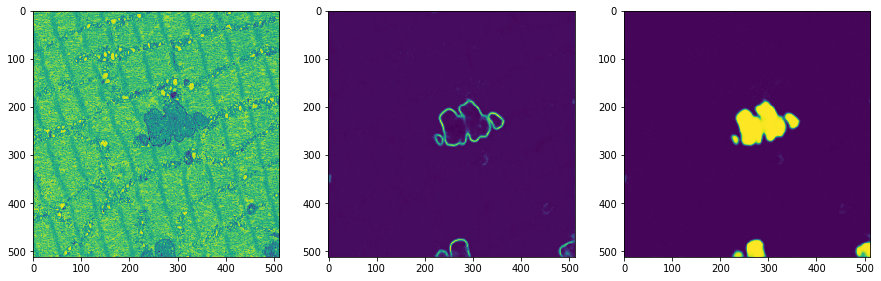

1600
Training loss:  0.007872763
(3, 512, 512, 2)
Validation loss:  0.0046318164


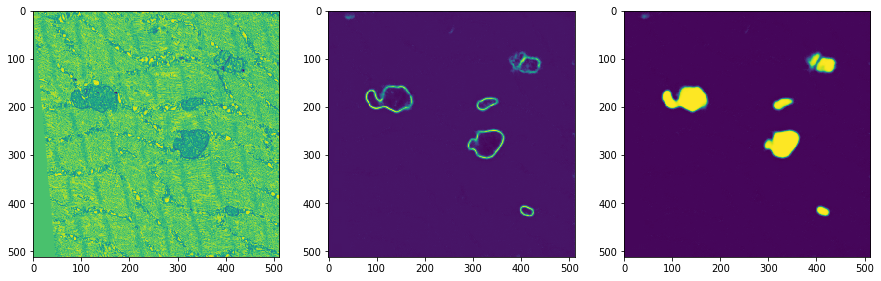

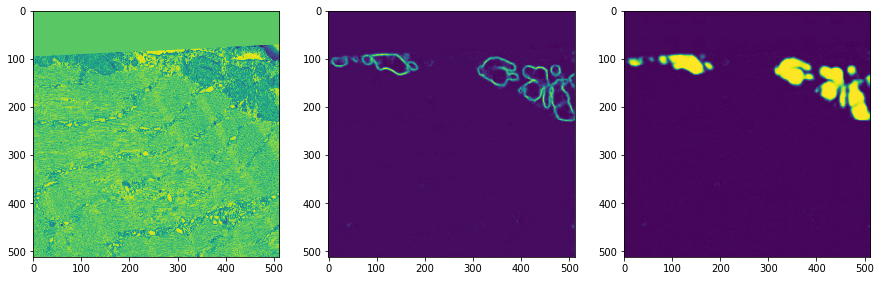

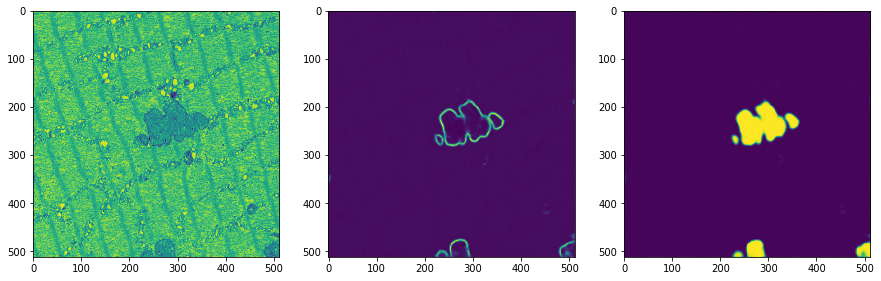

1700
Training loss:  0.007647643
(3, 512, 512, 2)
Validation loss:  0.0045695878


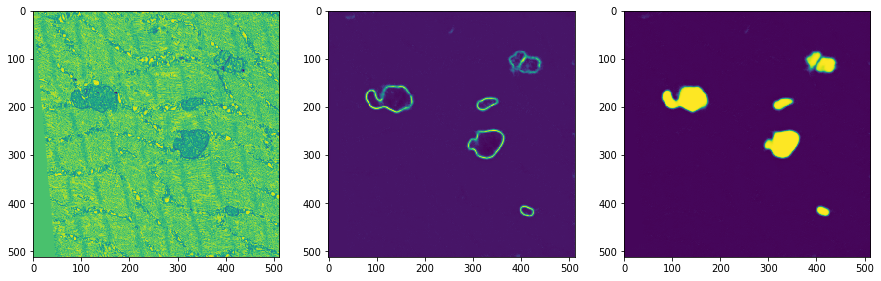

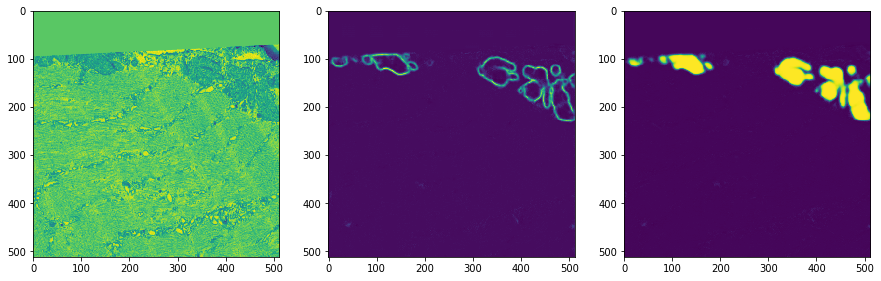

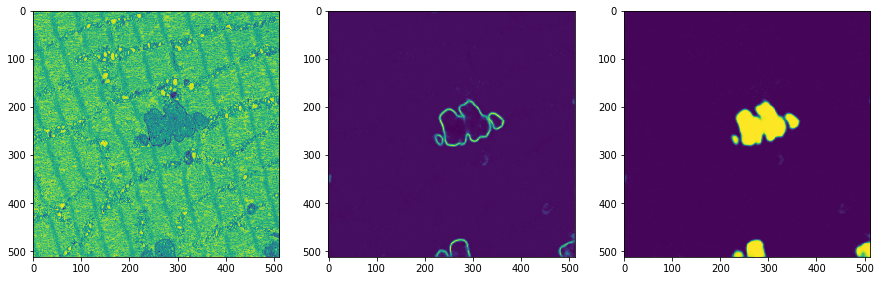

1800
Training loss:  0.005671088
(3, 512, 512, 2)
Validation loss:  0.0045387815


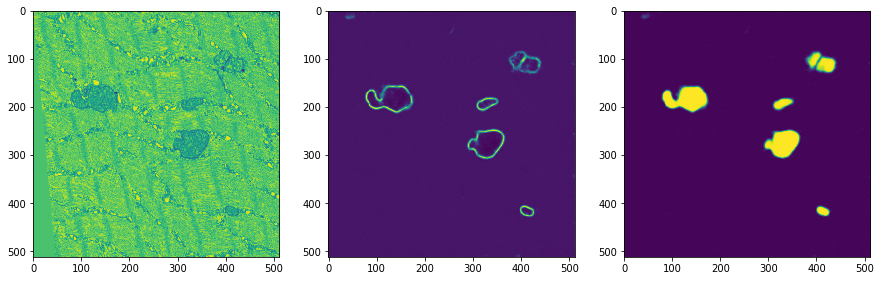

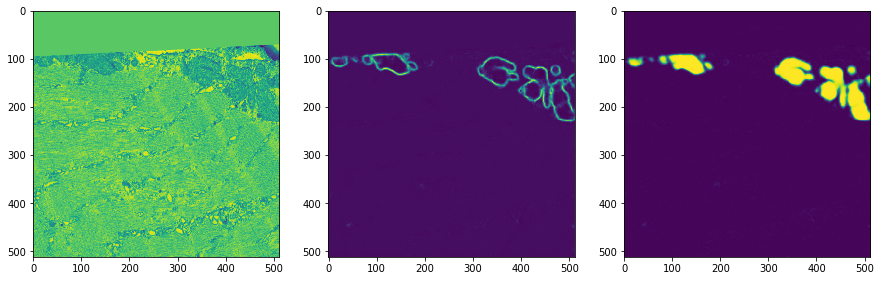

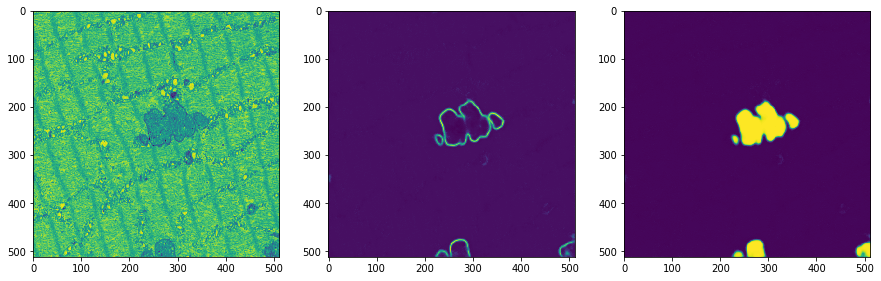

1900
Training loss:  0.0061997413
(3, 512, 512, 2)
Validation loss:  0.0044387146


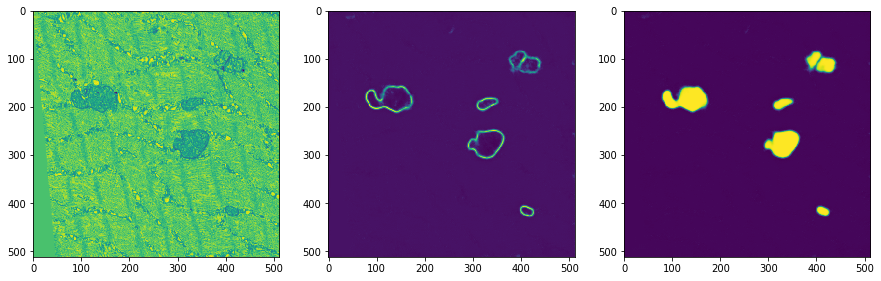

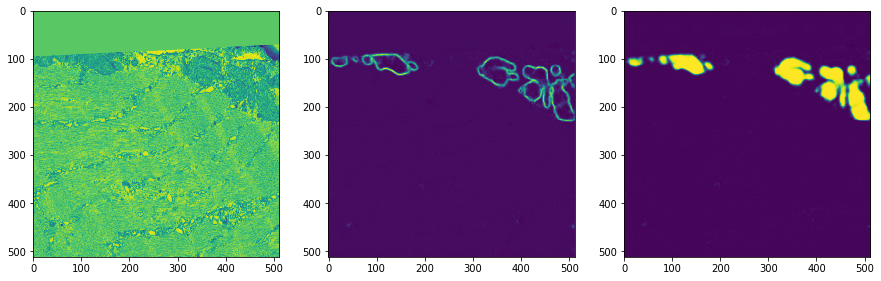

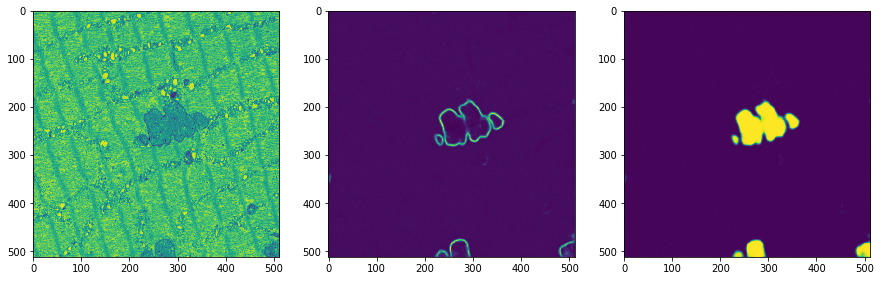

2000
Training loss:  0.005319134
(3, 512, 512, 2)
Validation loss:  0.004447524


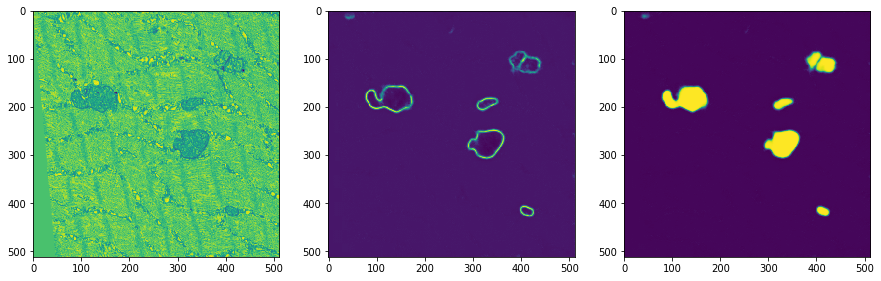

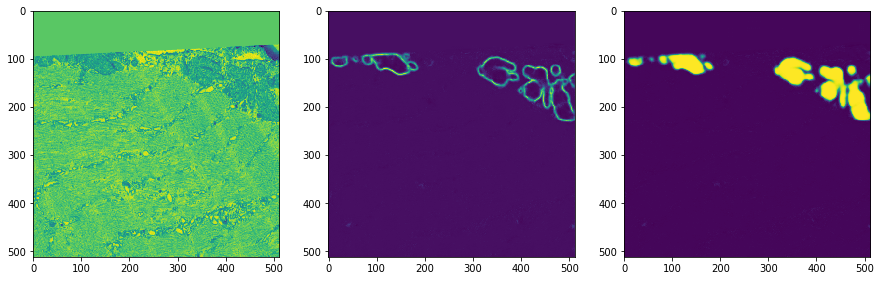

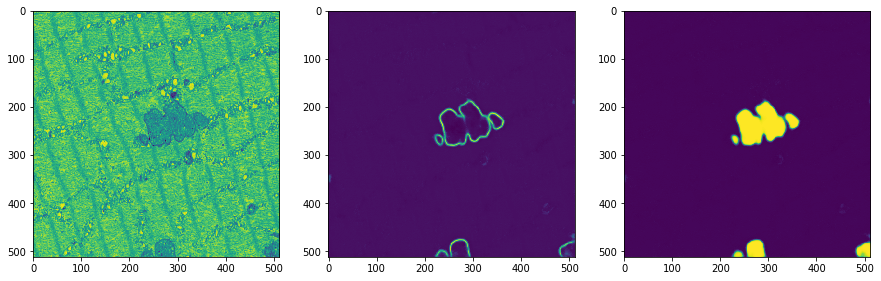

2100
Training loss:  0.0059513003
(3, 512, 512, 2)
Validation loss:  0.004334129


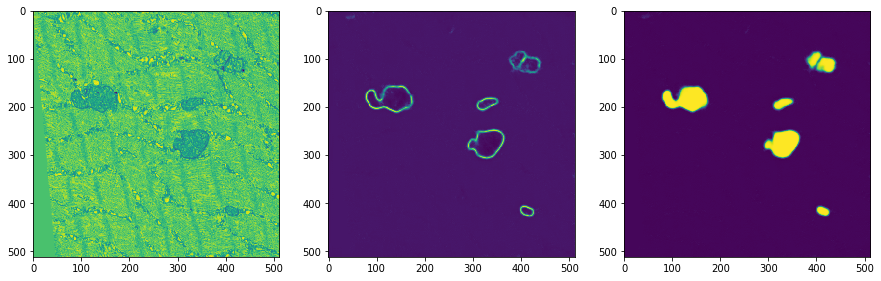

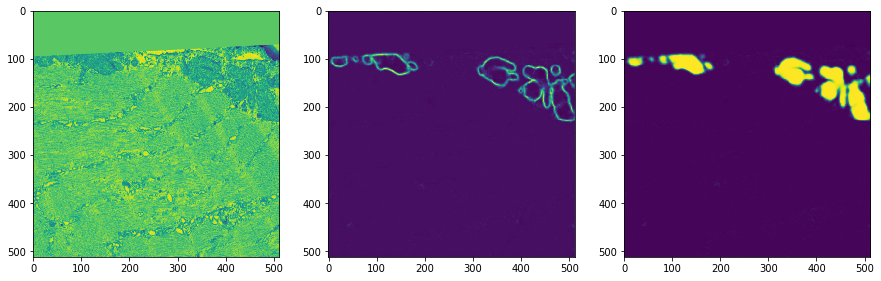

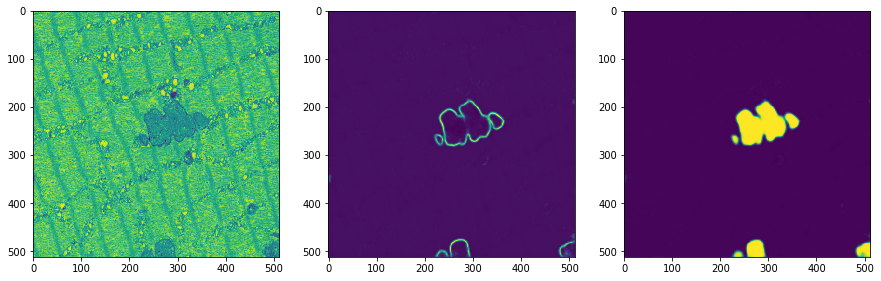

In [57]:
shutil.rmtree('./logs/')
tf.set_random_seed(123456)
saver = tf.train.Saver(max_to_keep=50)
#train_writer = tf.summary.FileWriter('./logs/1/train ', sess.graph)
test_writer = tf.summary.FileWriter('./logs/170/test')
current_best=[0,1000000000]


learning_rates=[0.00005, 0.00002, 0.00002, 0.00001]
learning_rate_steps=[500,1500, 2200, 2200]
current_step=0
for lrate, lrs in zip(learning_rates, learning_rate_steps):
    for i in range(current_step, lrs):
        idx=np.random.choice(train_data.shape[0], replace=False, size=[25])
        cur_train=train_data[idx,:,:,:]+np.random.uniform(-baseline_noise, baseline_noise, 1)
        cur_truth=train_truth[idx,:,:]
        _, results, losses=sess.run([train_op,  probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})
        #train_writer.add_summary(summary, i)
        if (i%100==0):
            print(i)
            print("Training loss: ",losses)
            #idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
            idx=range(0,3, 1)
            sub_validation_data=validation_data[idx, :,:,:]
            sub_validation_truth=validation_truth[idx, :,:]
            summary, results, losses=sess.run([merge, probs, loss], feed_dict={x:sub_validation_data, y:sub_validation_truth})
            test_writer.add_summary(summary, i)
            print(results.shape)
            print("Validation loss: ",losses)
            if (losses<current_best[1]):
                current_best=[i, losses]
                file=open(data+'Network.txt', 'w')
                file.write(str(base_scaler)+'\n')
                file.write(str(baseline_noise)+'\n')
                file.write(str(x_dim)+'\n')
                file.write(str(mean)+'\n')
                file.write(str(std)+'\n')
                file.write(str(i)+'\n')
                file.write(str(channels)+'\n')
                file.close()
            for ti in range (0,3):
                utils.plot_3x1(sub_validation_data[ti,:,:,0], results[ti,:,:,0], results[ti,:,:,1])
                plt.show()
            saver.save(sess, data+'NewModels/Model'+str(i))
    current_step=lrs